This notebook shows how to evaluate the F1 scores for a particular field. First, select four 256X256 pixel sub-fields for evaluation and record their coordinates. Next, create ground truth annotations of nuclei in GIMP for these four sub-fields. Try to get two sparse and two densely-packed regions of nuclei. Next, perform nuclear segmentation using various platforms and produce binary masks for evaluation and store all these in a folder with the filenames being the name of the platform. Run this notebook to get the F1 scores for each of the evaluation subfields. Run separate notebooks for each different field/WSI you are creating ground truth annotations/
evaluating. This notebooks allows for qualitative evaluation in the form of platform binary masks overlayed on ground truth masks for comparison as well quantitative evaluation in the form of F1-scores at various IoU thresholds.

After running a similar notebook for multiple fields of a dataset, use the all_fields.ipynb notebook to combine the data to quantitatively compare the nuclear segmentation performance of the platforms across all the fields sampled from a dataset. This should give an idea of the relative performances of the platforms across the entire dataset for nuclear segmentation.

In [1]:
import os
import skimage.io as io
import pandas as pd
import numpy as np
import skimage.morphology
import skimage.segmentation
import cv2
import matplotlib.pyplot as plt
from scipy.spatial.distance import directed_hausdorff as hausdorff
from scipy import stats
import sigfig
import seaborn as sns
from evaluation import accuracy_calculator
from evaluation import intersection_over_union
from evaluation import F1_score_calculator
sns.set_style("whitegrid")

In [2]:
# Change these filepaths to access files on a local machine

# Path to save the csv file contaning the platform F1-scores for each subfield at 0.5 IoU
F1_5IoU_csv_path = '/Users/abishek/Desktop/MRL/Platforms/code/nuclear_seg/F1_5IoU_csv/TME11.csv'
# Path to save the bar plot contaning the platform F1-scores at 0.5 IoU
F1_5IoU_plot_path = '/Users/abishek/Desktop/MRL/Platforms/code/nuclear_seg/F1_5IoU_plot/TME11.png'
# Path to save the csv file contaning the platform F1-scores for each subfield at a range of IoUs
F1_allIoU_csv_path = '/Users/abishek/Desktop/MRL/Platforms/code/nuclear_seg/F1_allIoU_csv/TME11.csv'
# Path to save the line plot contaning the platform F1-scores at a range of IoUs
F1_allIoU_plot_path = '/Users/abishek/Desktop/MRL/Platforms/code/nuclear_seg/F1_allIoU_plot/TME11.png'

# Path to the directory containing the binary masks of the whole field from each platform
platforms_dir_path = '/Users/abishek/Desktop/MRL/Platforms/Code/Fields/TME11_12154_44141/Platforms'

# Path to the directory the four ground truth sub fields
gr_tr_dir_path = '/Users/abishek/Desktop/MRL/Platforms/Code/Fields/TME11_12154_44141/ground_truth'

# Overall Path (the files have to be structured such that the platforms and ground truth folders are stored in this
# directory)
fields_pathdir = '/Users/abishek/Desktop/MRL/Platforms/Code/Fields'

# Coordinates of the top-left corener of the four subfields, with the dictionary keys being the names of the
# subfields
coordinate_dict = {'sparse1': (0, 1378),'dense1': (434, 691), 'sparse2': (1092, 231), 'dense2': (704, 939)}

# Path to save overlayed images (platform masks on ground truth) for qualitative evaluation of segmentation
eval_images_path = '/Users/abishek/Desktop/MRL/Platforms/code/nuclear_seg/eval_images/TME11'

In [3]:
# Reading the ground truth binary masks into arrays. Make sure that the ground truth binary masks are named
# according to the file name shown below
gr_tr_sparse1 = io.imread(os.path.join(gr_tr_dir_path, 'gr_tr_sparse1.tiff'))
gr_tr_sparse2 = io.imread(os.path.join(gr_tr_dir_path, 'gr_tr_sparse2.tiff'))
gr_tr_dense1 = io.imread(os.path.join(gr_tr_dir_path, 'gr_tr_dense1.tiff'))
gr_tr_dense2 = io.imread(os.path.join(gr_tr_dir_path, 'gr_tr_dense2.tiff'))
# Dictionary with keys being the string containing the name of the subfield and the values being the ground 
# truth arrays
gr_tr_mask_dict = {'sparse1': gr_tr_sparse1, 'sparse2': gr_tr_sparse2, 'dense1': gr_tr_dense1,
                   'dense2': gr_tr_dense2}

The below code is used to generate a dataframe where the columns are the platforms being implemented and the rows are the F1 scores for each evaluation subfield at 0.5 intersection over union (IoU) threshold. This means that a predicted nucleus has to have at least 0.5 IoU to be counted as a true positive. Having an IoU of 0.5 or above ensures that there is a maximum of one true positive predicted nucleus for every ground truth nucleus. The code is also used to generate the overlays of platform nuclei masks on ground truth nuclei masks for qualitative evaluation.

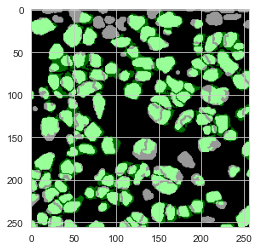

ilastik_sparse1
53 44 85 138
0.4510638297853146 5.115550718454057


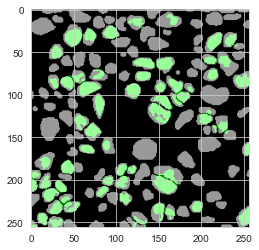

CellProfiler_sparse1
32 18 106 138
0.34042553191308284 4.544913206717571


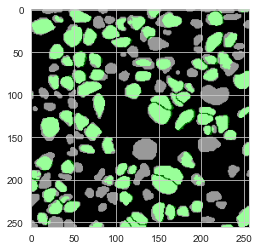

CellPose_sparse1
68 9 70 138
0.6325581395319416 3.3899401647511818


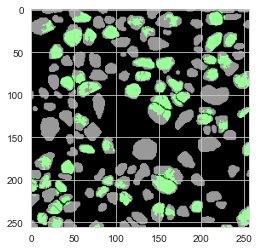

Fiji_sparse1
33 27 105 138
0.33333333333164983 4.445970569106015


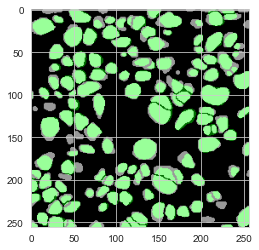

StarDist_sparse1
99 23 39 138
0.7615384615355326 3.184979326539974


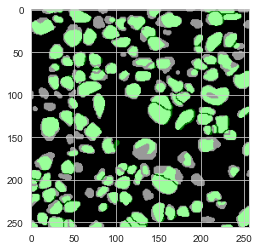

InForm_sparse1
82 20 56 138
0.6833333333304862 4.065895261366496


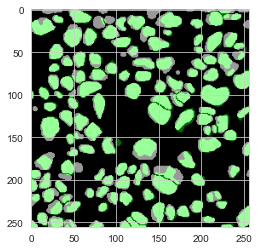

QuPath_sparse1
100 20 38 138
0.7751937984466079 3.6527918344569694


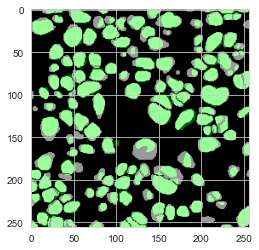

Mesmer_sparse1
95 45 43 138
0.6834532374076135 3.2569762223549494


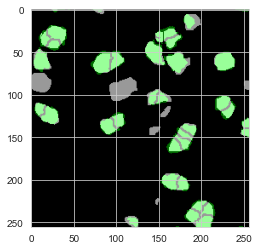

ilastik_sparse2
8 31 18 26
0.24615384615005917 7.3491485064993185


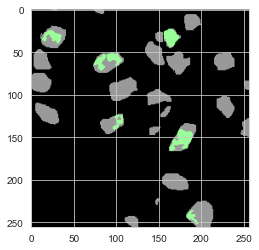

CellProfiler_sparse2
2 6 24 26
0.11764705882006922 5.8350245547781965


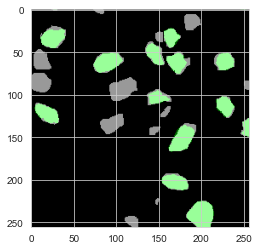

CellPose_sparse2
13 2 13 26
0.6341463414479477 3.114579367012536


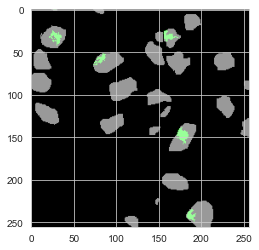

Fiji_sparse2
0 6 26 26
0.0 0


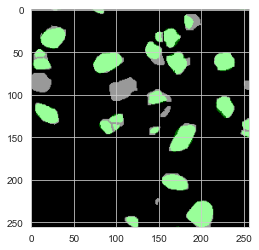

StarDist_sparse2
19 10 7 26
0.690909090896529 3.939364583391167


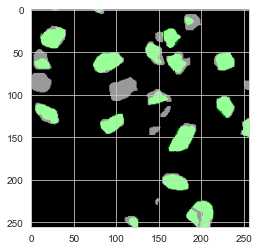

InForm_sparse2
16 5 10 26
0.6808510638153011 4.401713132004393


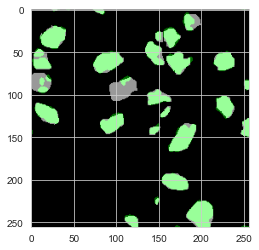

QuPath_sparse2
23 11 3 26
0.7666666666538889 2.9387241684034224


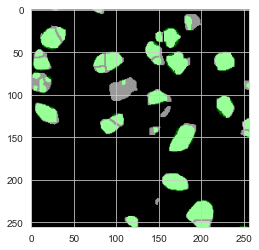

Mesmer_sparse2
16 22 10 26
0.49999999999218747 5.777272479728876


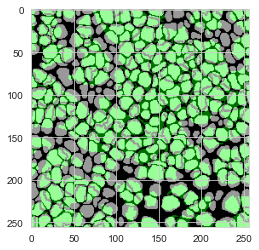

ilastik_dense1
38 117 267 305
0.16521739130398866 5.669614769506333


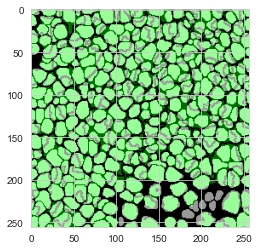

CellProfiler_dense1
60 115 245 305
0.24999999999947917 6.0718943044772065


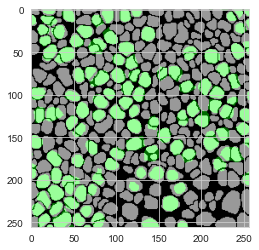

CellPose_dense1
86 33 219 305
0.40566037735753385 3.3103581551940304


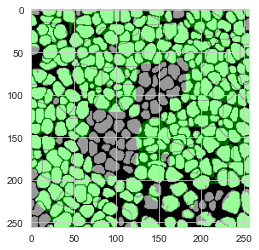

Fiji_dense1
58 64 247 305
0.27166276346540597 4.4333470877074355


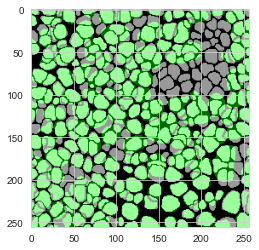

StarDist_dense1
77 75 228 305
0.33698030634499565 4.316159412402081


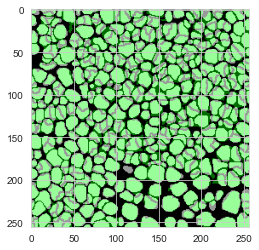

InForm_dense1
99 203 206 305
0.32619439868150546 4.854185832039351


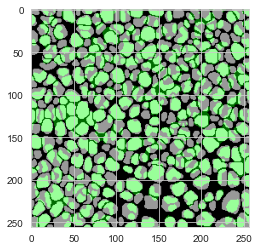

QuPath_dense1
69 149 236 305
0.2638623326954802 4.295531414791387


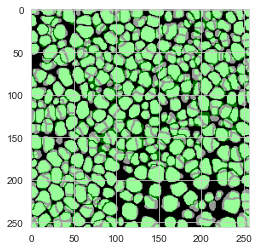

Mesmer_dense1
155 166 150 305
0.49520766773083835 3.724938281566845


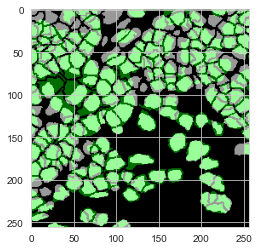

ilastik_dense2
40 91 141 181
0.2564102564094346 5.589803156700169


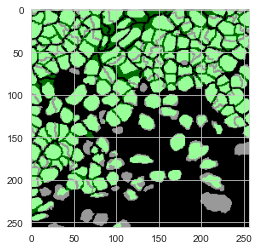

CellProfiler_dense2
53 65 128 181
0.3545150501660384 5.083842698673021


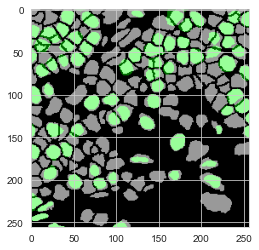

CellPose_dense2
61 17 120 181
0.4710424710406524 3.5143949027172594


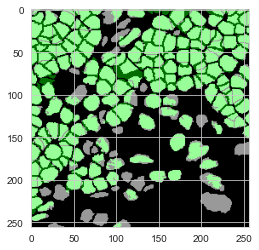

Fiji_dense2
65 47 116 181
0.4436860068244243 4.355251968509576


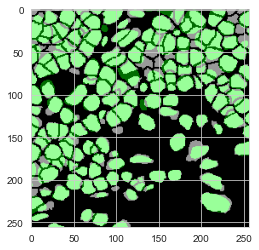

StarDist_dense2
101 37 80 181
0.6332288401234069 4.05958502943318


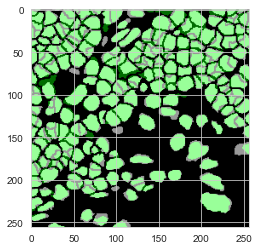

InForm_dense2
100 96 81 181
0.5305039787784337 3.9740089131756906


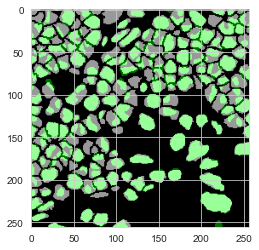

QuPath_dense2
63 93 118 181
0.3738872403549736 3.5938154189332554


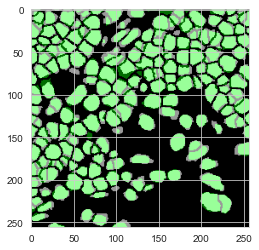

Mesmer_dense2
141 60 40 181
0.7382198952860256 3.545537514969527


In [4]:
# this dictionary will be populated with subfield names and their associated F1 scores for each platform. Alter
# the keys of the dictionary to include the platforms being implemented
df_dict_F1 = {'subfield': [], 'ilastik': [], 'CellProfiler': [], 'Fiji': [], 'QuPath': [],
                            'Mesmer': [], 'InForm': [], 'CellPose': [], 'StarDist': []}
# initializing the ground truth nuclei count to be incremented
gr_tr_nuclei_count = []
# iterating over all 4 subfields
for subfield in gr_tr_mask_dict.keys():
    # iterating over each platform's binary mask
    for img in os.listdir(platforms_dir_path):
        # processes only tiff files
        if img[-5:]=='.tiff' or img[-4:]=='.tif':
            platform_whole_img = io.imread(os.path.join(platforms_dir_path, img))
            platform = img[:img.find('.')]
            # adds a new entry in the dictionary for the subfield if it is not already added
            if subfield not in df_dict_F1['subfield']:
                df_dict_F1['subfield'].append(subfield)
            else:
                pass
            # gets the ground truth mask for the current subfield
            gr_tr_img = gr_tr_mask_dict[subfield]
            # gets the coordinates for the current subfield
            top_left_row = coordinate_dict[subfield][0]
            top_left_column = coordinate_dict[subfield][1]
            # crops the platform binary mask to isolate the region to be evaluated
            platform_img = platform_whole_img[top_left_row:top_left_row+256, top_left_column:top_left_column+256]
            # creating a ground truth binary mask for visualization purposes in white and black
            gr_tr_img_show = np.uint8(np.zeros((gr_tr_img.shape[0], gr_tr_img.shape[1], 3)))
            gr_tr_img_show[gr_tr_img == 255] = [255, 255, 255]
            # creating a ground truth binary mask for visualization purposes in green and black
            platform_img_show = np.uint8(np.zeros((platform_img.shape[0], platform_img.shape[1], 3)))
            platform_img_show[platform_img == 255] = [0, 120, 0]
            # overlaying the platform over the ground truth binary mask
            dst = cv2.addWeighted(gr_tr_img_show, 0.6, platform_img_show, 0.9, 0)
            # for visualization in the notebook
            plt.imshow(dst)
            plt.show()
            # to save the overlayed images for qualitative evaluation
            io.imsave(os.path.join(eval_images_path, platform + '_' + subfield + '.tiff'), dst)

            print(platform + '_' + subfield)
            accuracy = accuracy_calculator(platform_img, gr_tr_img)
            # calculating the F1-score of the current platform subfield
            F1, nuclei_count, cur_gr_tr_nuclei_count, aHD = F1_score_calculator(platform_img, gr_tr_img, 0.5)
            # Adding the F1-score to the F1-score dictionary
            df_dict_F1[platform].append(F1)
        else:
            pass
    # updating the ground truth nuclei count for the current subfield    
    gr_tr_nuclei_count.append(cur_gr_tr_nuclei_count)
# Adding up the ground truth nuclei in all the subfields
gr_tr_nuclei_count = sum(gr_tr_nuclei_count)

# Converting the F1-score dictionary to a dataframe
df_F1 = pd.DataFrame(df_dict_F1)
# Setting the index to be the subfield name
df_F1 = df_F1.set_index('subfield')

In [5]:
print(f'{gr_tr_nuclei_count} ground truth nuclei have been segmented.')

650 ground truth nuclei have been segmented.


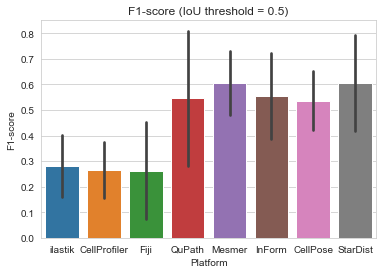

In [6]:
# Creating a barplot with errorbars being one standard deviation
F1_barplot = sns.barplot(data=df_F1, errorbar='sd')
F1_barplot.set(xlabel ="Platform", ylabel = "F1-score", title ='F1-score (IoU threshold = 0.5)')
# saving this figure
plt.savefig(F1_5IoU_plot_path, dpi=500)

In [7]:
# converting the dataframe with the F1-scores at 0.5 IoU to a csv file
df_F1.to_csv(F1_5IoU_csv_path)

The below block of code is used to generate a dataframe where the columns are platforms to be evaluated and the rows are the average F1-scores over the 4 subfields at various IoU thresholds (rows correspond to IoU thresholds).

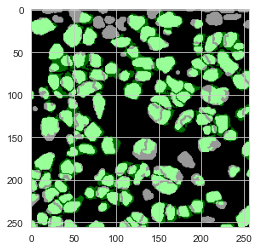

ilastik_sparse1
53 44 85 138
0.4510638297853146 5.115550718454057


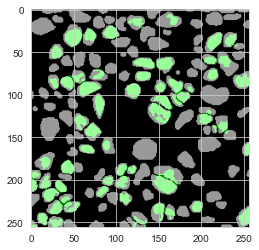

CellProfiler_sparse1
32 18 106 138
0.34042553191308284 4.544913206717571


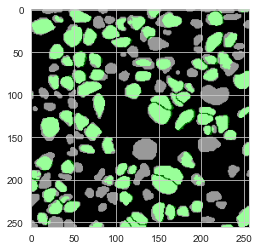

CellPose_sparse1
68 9 70 138
0.6325581395319416 3.3899401647511818


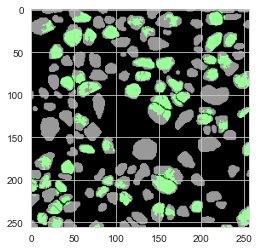

Fiji_sparse1
33 27 105 138
0.33333333333164983 4.445970569106015


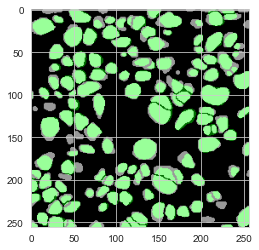

StarDist_sparse1
99 23 39 138
0.7615384615355326 3.184979326539974


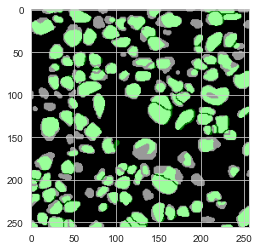

InForm_sparse1
82 20 56 138
0.6833333333304862 4.065895261366496


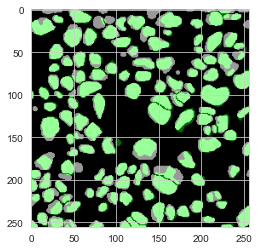

QuPath_sparse1
100 20 38 138
0.7751937984466079 3.6527918344569694


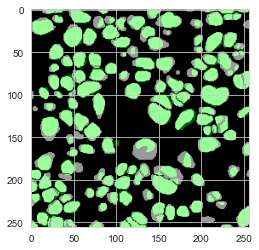

Mesmer_sparse1
95 45 43 138
0.6834532374076135 3.2569762223549494


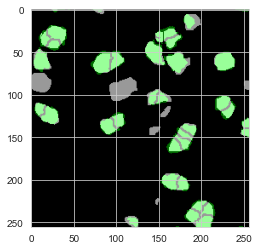

ilastik_sparse2
8 31 18 26
0.24615384615005917 7.3491485064993185


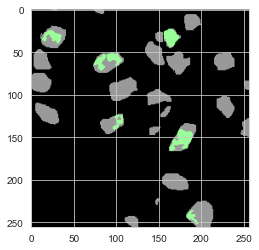

CellProfiler_sparse2
2 6 24 26
0.11764705882006922 5.8350245547781965


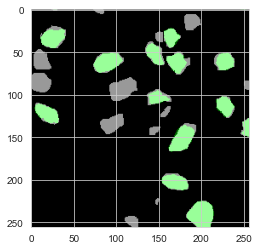

CellPose_sparse2
13 2 13 26
0.6341463414479477 3.114579367012536


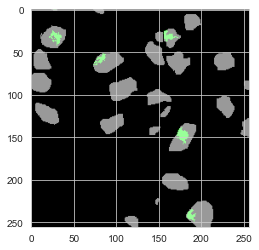

Fiji_sparse2
0 6 26 26
0.0 0


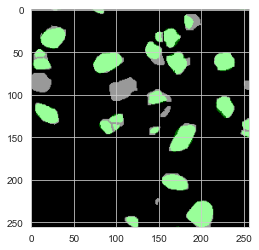

StarDist_sparse2
19 10 7 26
0.690909090896529 3.939364583391167


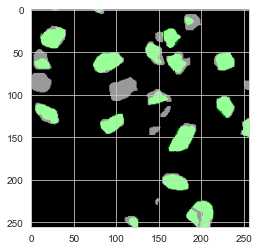

InForm_sparse2
16 5 10 26
0.6808510638153011 4.401713132004393


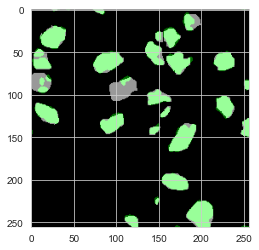

QuPath_sparse2
23 11 3 26
0.7666666666538889 2.9387241684034224


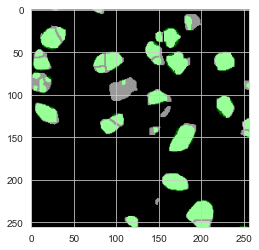

Mesmer_sparse2
16 22 10 26
0.49999999999218747 5.777272479728876


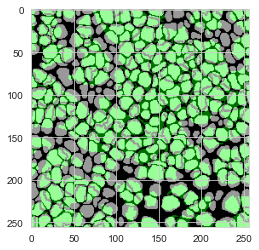

ilastik_dense1
38 117 267 305
0.16521739130398866 5.669614769506333


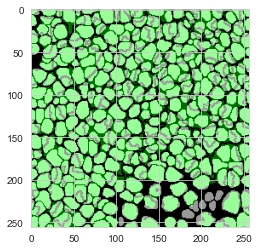

CellProfiler_dense1
60 115 245 305
0.24999999999947917 6.0718943044772065


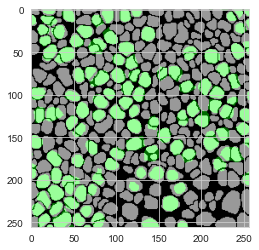

CellPose_dense1
86 33 219 305
0.40566037735753385 3.3103581551940304


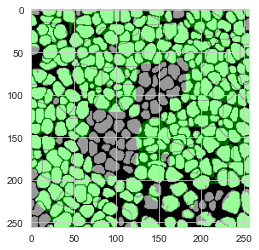

Fiji_dense1
58 64 247 305
0.27166276346540597 4.4333470877074355


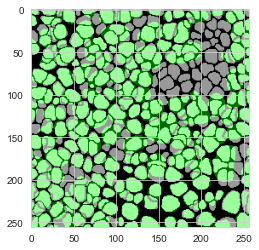

StarDist_dense1
77 75 228 305
0.33698030634499565 4.316159412402081


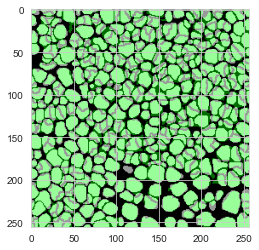

InForm_dense1
99 203 206 305
0.32619439868150546 4.854185832039351


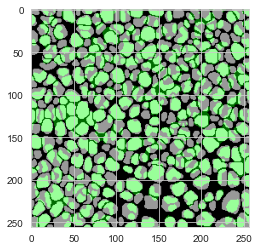

QuPath_dense1
69 149 236 305
0.2638623326954802 4.295531414791387


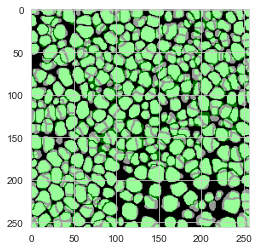

Mesmer_dense1
155 166 150 305
0.49520766773083835 3.724938281566845


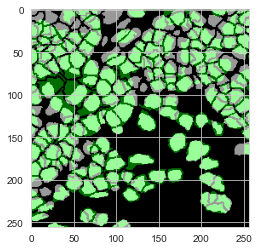

ilastik_dense2
40 91 141 181
0.2564102564094346 5.589803156700169


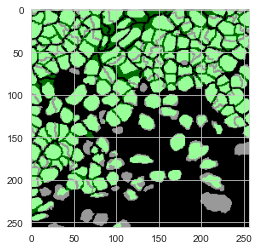

CellProfiler_dense2
53 65 128 181
0.3545150501660384 5.083842698673021


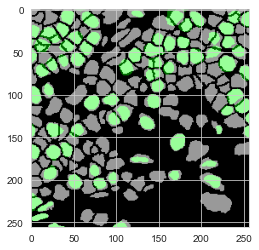

CellPose_dense2
61 17 120 181
0.4710424710406524 3.5143949027172594


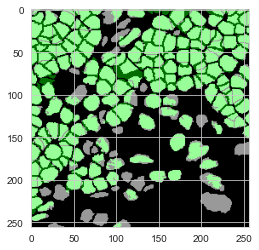

Fiji_dense2
65 47 116 181
0.4436860068244243 4.355251968509576


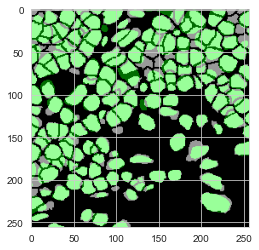

StarDist_dense2
101 37 80 181
0.6332288401234069 4.05958502943318


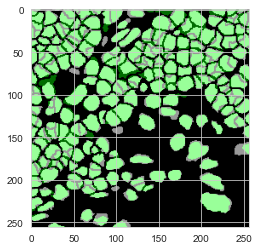

InForm_dense2
100 96 81 181
0.5305039787784337 3.9740089131756906


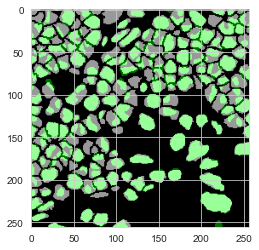

QuPath_dense2
63 93 118 181
0.3738872403549736 3.5938154189332554


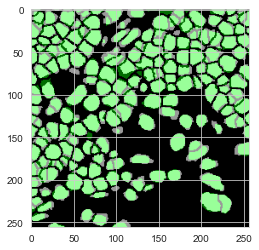

Mesmer_dense2
141 60 40 181
0.7382198952860256 3.545537514969527


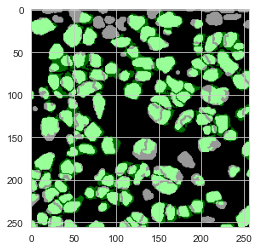

ilastik_sparse1
45 52 93 138
0.3829787234026256 4.825609893495127


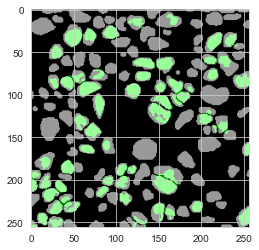

CellProfiler_sparse1
25 25 113 138
0.265957446807096 3.828923521496461


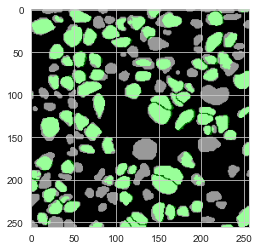

CellPose_sparse1
63 14 75 138
0.5860465116251812 3.0520124617169


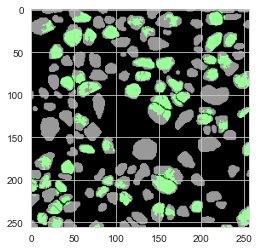

Fiji_sparse1
28 32 110 138
0.2828282828268544 4.140426929805545


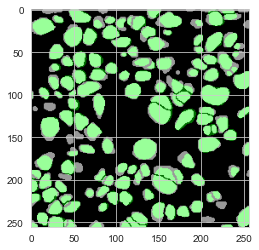

StarDist_sparse1
91 31 47 138
0.6999999999973078 2.941755848740788


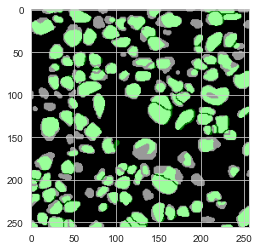

InForm_sparse1
74 28 64 138
0.6166666666640972 3.727977898349016


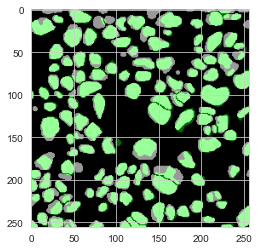

QuPath_sparse1
92 28 46 138
0.7131782945708792 3.27639354448719


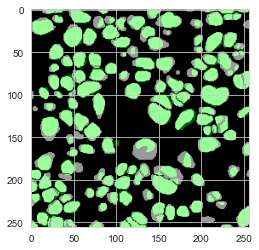

Mesmer_sparse1
90 50 48 138
0.6474820143861602 3.1306814673764625


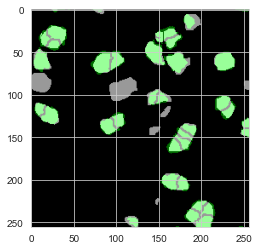

ilastik_sparse2
6 33 20 26
0.18461538461254437 5.015138774950427


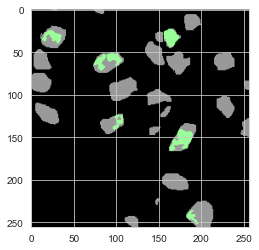

CellProfiler_sparse2
2 6 24 26
0.11764705882006922 5.8350245547781965


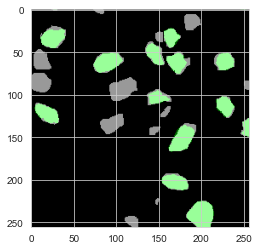

CellPose_sparse2
13 2 13 26
0.6341463414479477 3.114579367012536


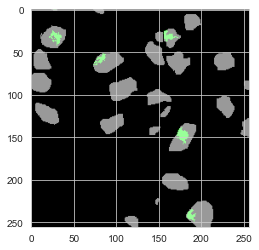

Fiji_sparse2
0 6 26 26
0.0 0


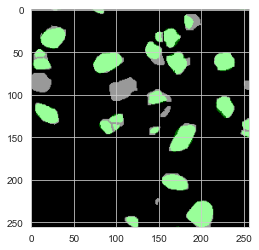

StarDist_sparse2
18 11 8 26
0.6545454545335537 3.7103149631185346


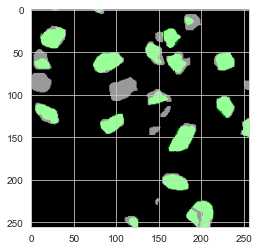

InForm_sparse2
16 5 10 26
0.6808510638153011 4.401713132004393


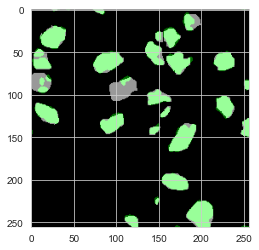

QuPath_sparse2
23 11 3 26
0.7666666666538889 2.9387241684034224


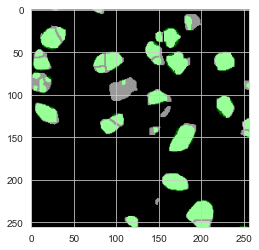

Mesmer_sparse2
14 24 12 26
0.437499999993164 4.619632098413752


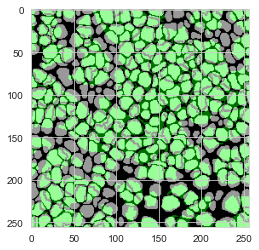

ilastik_dense1
21 134 284 305
0.09130434782588848 5.150069282860401


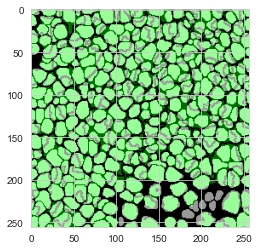

CellProfiler_dense1
51 124 254 305
0.2124999999995573 5.138040527434434


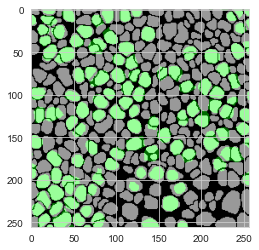

CellPose_dense1
80 39 225 305
0.37735849056514775 3.104245295569258


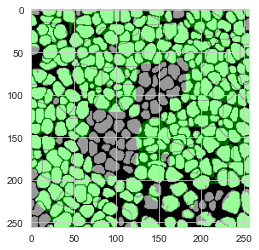

Fiji_dense1
51 71 254 305
0.2388758782195811 4.169401134116585


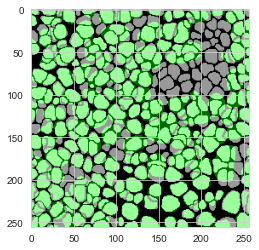

StarDist_dense1
64 88 241 305
0.28008752735168474 3.681798790597312


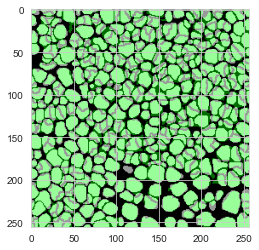

InForm_dense1
82 220 223 305
0.2701812191099338 4.10666057120238


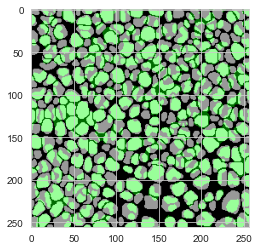

QuPath_dense1
62 156 243 305
0.23709369024811264 4.023484761351324


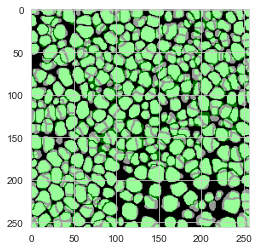

Mesmer_dense1
136 185 169 305
0.4345047923315743 3.3473890457407247


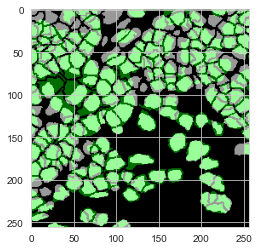

ilastik_dense2
30 101 151 181
0.19230769230707595 4.752986559195685


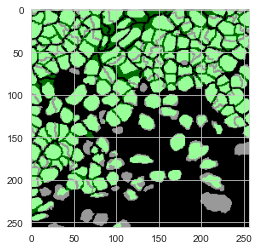

CellProfiler_dense2
42 76 139 181
0.2809364548485587 3.9781104465901924


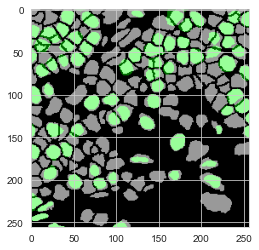

CellPose_dense2
58 20 123 181
0.44787644787471864 3.399621224989575


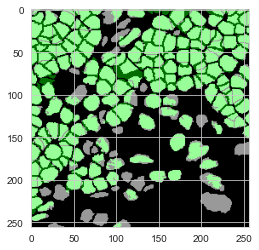

Fiji_dense2
61 51 120 181
0.41638225255830585 3.948990769436911


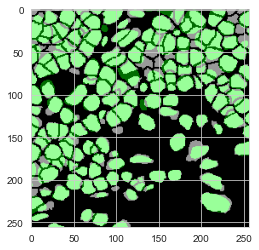

StarDist_dense2
88 50 93 181
0.551724137929305 3.4309624099876475


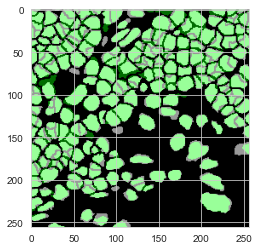

InForm_dense2
90 106 91 181
0.4774535809005903 3.352286002930169


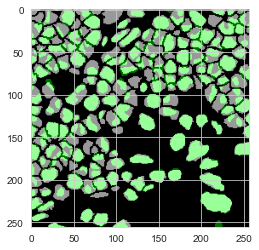

QuPath_dense2
58 98 123 181
0.34421364985061065 3.2716503969340027


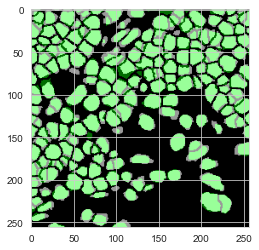

Mesmer_dense2
128 73 53 181
0.6701570680610729 3.3649743505052645


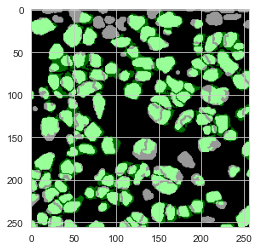

ilastik_sparse1
32 65 106 138
0.272340425530756 4.457629053848984


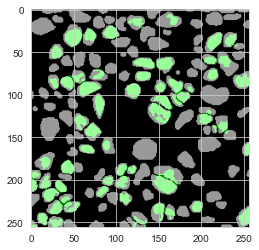

CellProfiler_sparse1
21 29 117 138
0.22340425531796063 3.7460899119167133


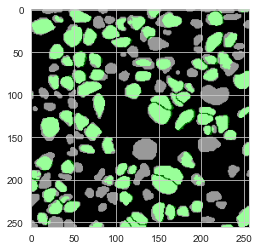

CellPose_sparse1
61 16 77 138
0.567441860462477 2.995268576894483


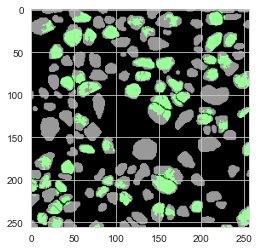

Fiji_sparse1
24 36 114 138
0.24242424242301808 3.6807905737671995


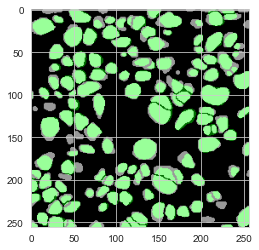

StarDist_sparse1
86 36 52 138
0.6615384615359172 2.796339017911009


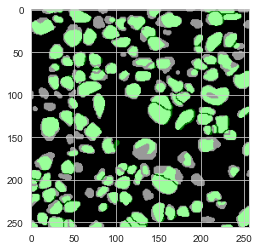

InForm_sparse1
65 37 73 138
0.5416666666644098 3.296674605287149


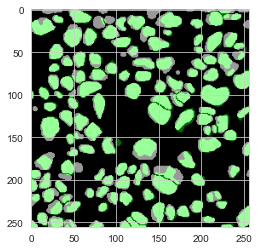

QuPath_sparse1
87 33 51 138
0.6744186046485487 3.0830417090798754


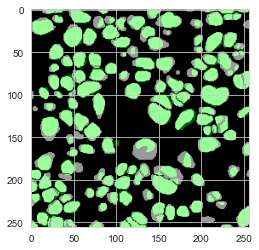

Mesmer_sparse1
87 53 51 138
0.6258992805732881 3.0798238877872373


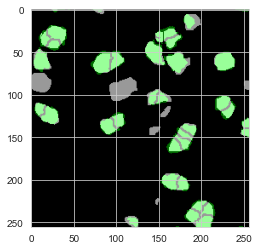

ilastik_sparse2
4 35 22 26
0.12307692307502958 3.371320343559643


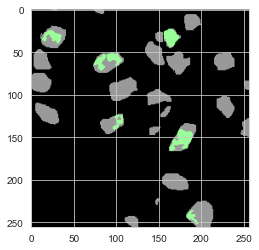

CellProfiler_sparse2
1 7 25 26
0.05882352941003461 2.23606797749979


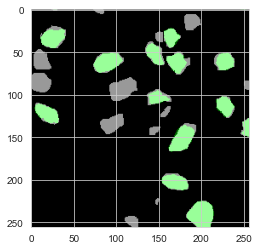

CellPose_sparse2
13 2 13 26
0.6341463414479477 3.114579367012536


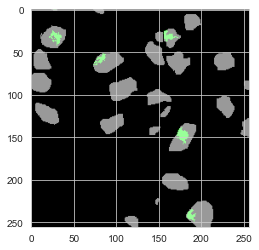

Fiji_sparse2
0 6 26 26
0.0 0


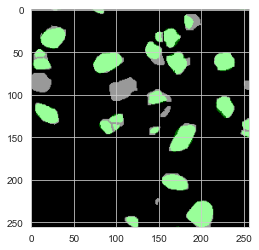

StarDist_sparse2
15 14 11 26
0.5454545454446281 3.303306757242257


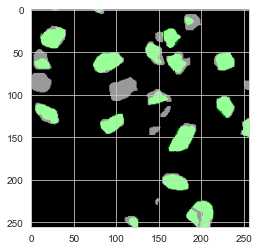

InForm_sparse2
13 8 13 26
0.5531914893499321 3.399589208800321


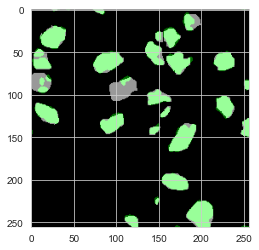

QuPath_sparse2
22 12 4 26
0.7333333333211112 2.608755311186052


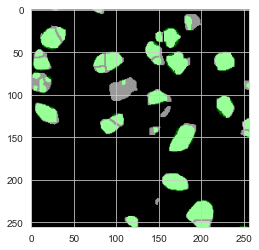

Mesmer_sparse2
12 26 14 26
0.37499999999414063 4.256022100726132


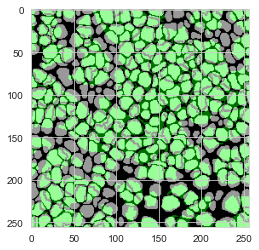

ilastik_dense1
13 142 292 305
0.05652173913031191 4.441427916130641


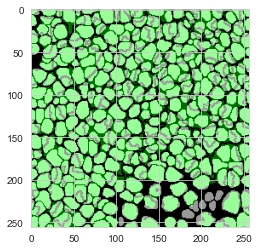

CellProfiler_dense1
41 134 264 305
0.17083333333297743 4.502175704170629


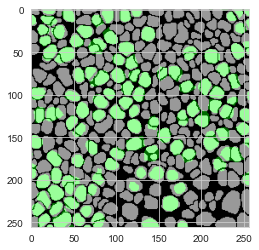

CellPose_dense1
72 47 233 305
0.33962264150863297 2.8732486969318796


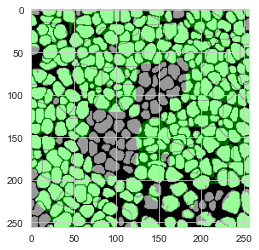

Fiji_dense1
44 78 261 305
0.20608899297375624 3.4678853877371054


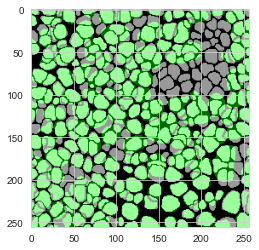

StarDist_dense1
58 94 247 305
0.25382932166246425 3.3460387741977082


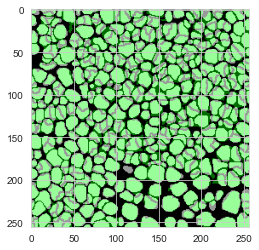

InForm_dense1
67 235 238 305
0.22075782537031177 3.635557511897949


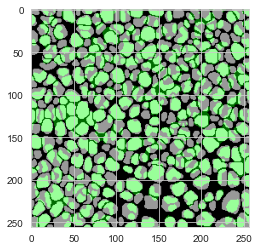

QuPath_dense1
45 173 260 305
0.17208413001879144 3.5646468376609044


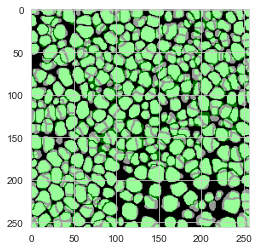

Mesmer_dense1
119 202 186 305
0.3801916932901275 3.1801480126752635


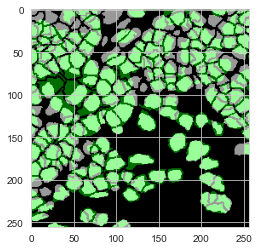

ilastik_dense2
23 108 158 181
0.1474358974354249 4.115782069206875


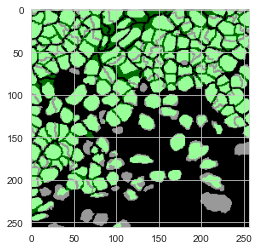

CellProfiler_dense2
39 79 142 181
0.26086956521651883 3.881291762307435


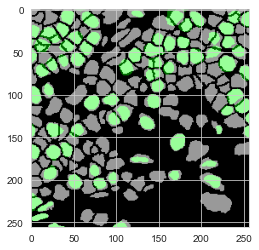

CellPose_dense2
52 26 129 181
0.4015444015428512 3.2590389394665924


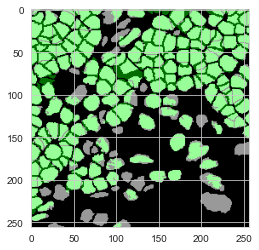

Fiji_dense2
51 61 130 181
0.3481228668930098 3.355605960912754


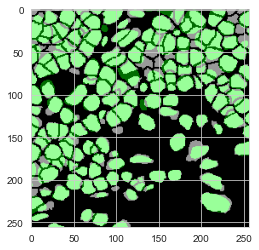

StarDist_dense2
83 55 98 181
0.520376175546958 3.30514823044014


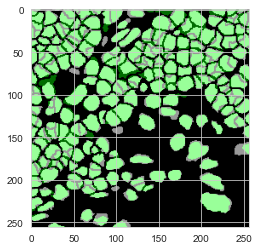

InForm_dense2
82 114 99 181
0.43501326259831563 3.150468250848686


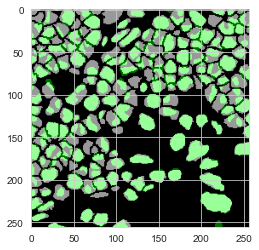

QuPath_dense2
51 105 130 181
0.3026706231445025 3.1455038839036034


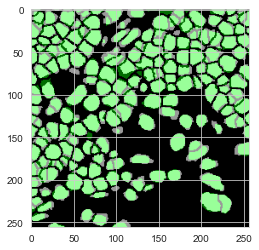

Mesmer_dense2
115 86 66 181
0.6020942408361202 3.091137376187821


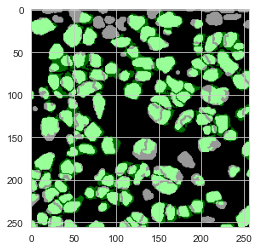

ilastik_sparse1
25 72 113 138
0.21276595744590313 4.1266030351866645


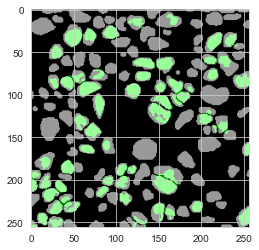

CellProfiler_sparse1
14 36 124 138
0.14893617021197375 3.781095309716941


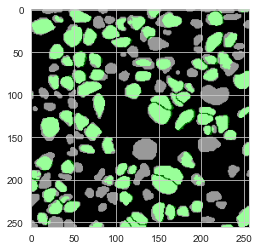

CellPose_sparse1
56 21 82 138
0.5209302325557166 2.746340068457474


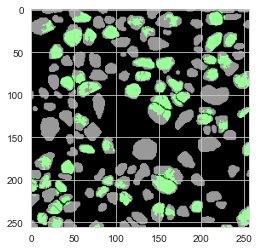

Fiji_sparse1
18 42 120 138
0.18181818181726356 3.562601776501831


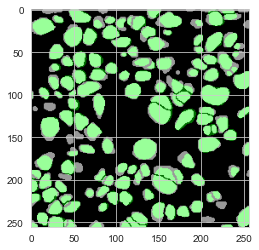

StarDist_sparse1
75 47 63 138
0.576923076920858 2.689201312921448


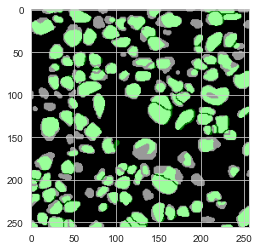

InForm_sparse1
55 47 83 138
0.4583333333314236 3.129585284114538


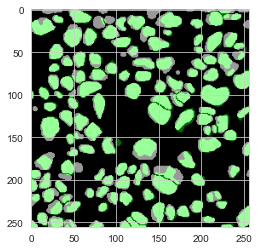

QuPath_sparse1
64 56 74 138
0.49612403100582897 2.8457746761141345


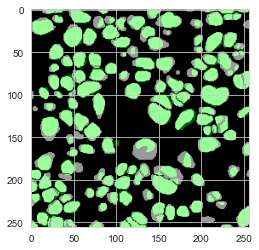

Mesmer_sparse1
74 66 64 138
0.5323741007175095 2.9768897046130958


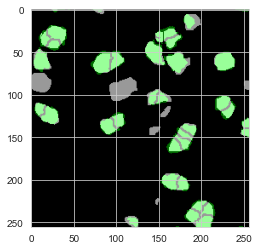

ilastik_sparse2
4 35 22 26
0.12307692307502958 3.371320343559643


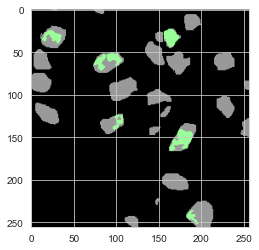

CellProfiler_sparse2
1 7 25 26
0.05882352941003461 2.23606797749979


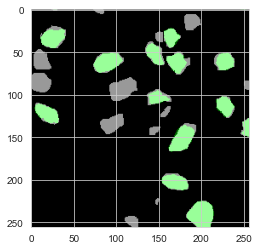

CellPose_sparse2
13 2 13 26
0.6341463414479477 3.114579367012536


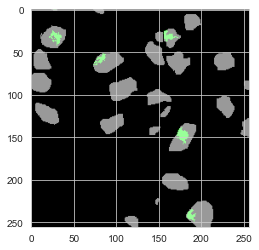

Fiji_sparse2
0 6 26 26
0.0 0


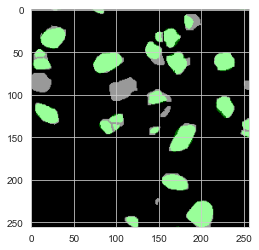

StarDist_sparse2
14 15 12 26
0.5090909090816529 3.1546026108213825


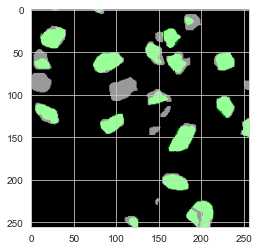

InForm_sparse2
13 8 13 26
0.5531914893499321 3.399589208800321


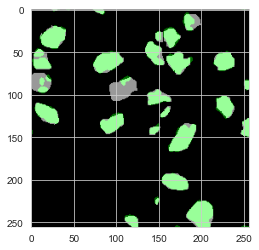

QuPath_sparse2
19 15 7 26
0.6333333333227779 2.5553156627962825


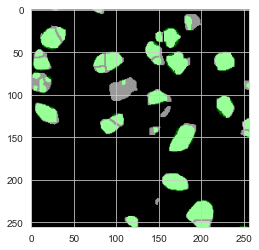

Mesmer_sparse2
11 27 15 26
0.3437499999946289 3.544474475919911


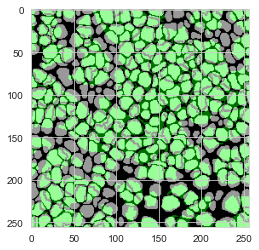

ilastik_dense1
6 149 299 305
0.02608695652168242 3.8738019854513523


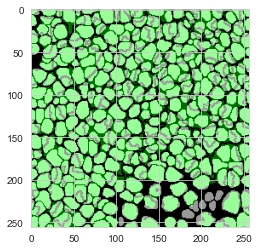

CellProfiler_dense1
33 142 272 305
0.13749999999971355 3.6537985179182555


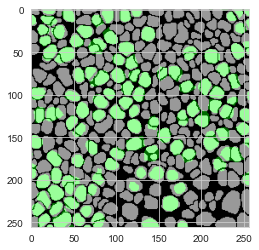

CellPose_dense1
61 58 244 305
0.28773584905592514 2.621351617426057


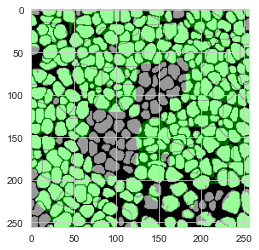

Fiji_dense1
40 82 265 305
0.18735362997614202 3.278886864997292


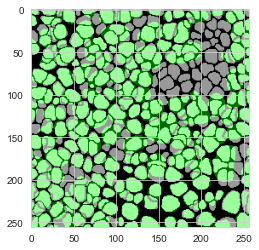

StarDist_dense1
48 104 257 305
0.21006564551376353 2.966653447103237


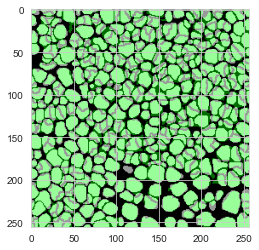

InForm_dense1
57 245 248 305
0.18780889621056374 3.3045625937999867


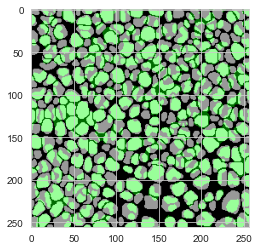

QuPath_dense1
33 185 272 305
0.12619502868044705 3.187066408902143


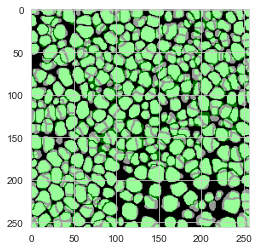

Mesmer_dense1
98 223 207 305
0.3130990415330462 2.964098426736372


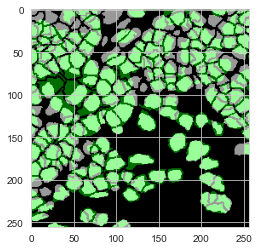

ilastik_dense2
10 121 171 181
0.06410256410235865 3.754560327021237


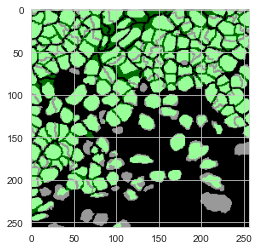

CellProfiler_dense2
33 85 148 181
0.220735785952439 3.463600966070367


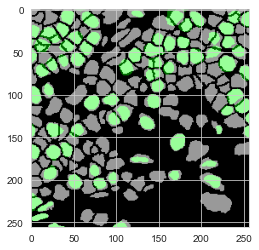

CellPose_dense2
42 36 139 181
0.3243243243230721 3.0075744705762992


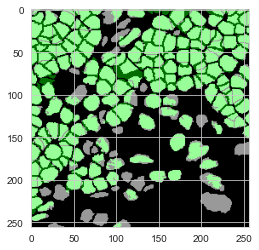

Fiji_dense2
45 67 136 181
0.3071672354938322 3.0453819760772687


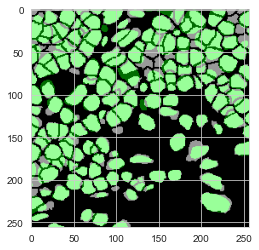

StarDist_dense2
72 66 109 181
0.45141065830579497 2.987896878196708


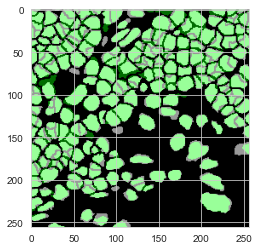

InForm_dense2
73 123 108 181
0.3872679045082566 3.008855925352983


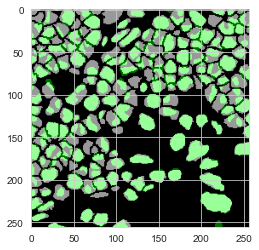

QuPath_dense2
45 111 136 181
0.2670623145392669 2.819721730665161


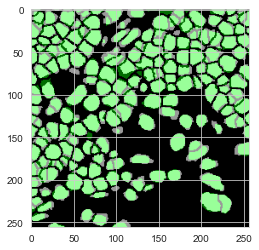

Mesmer_dense2
110 91 71 181
0.5759162303649845 3.0704305921167148


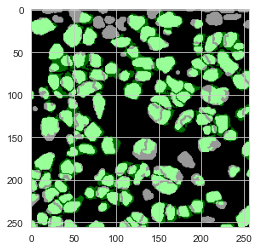

ilastik_sparse1
18 79 120 138
0.15319148936105026 3.602853268914958


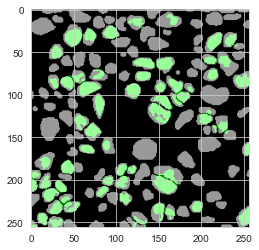

CellProfiler_sparse1
6 44 132 138
0.06382978723370304 3.4655253338879386


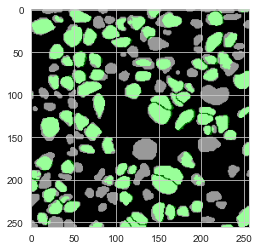

CellPose_sparse1
48 29 90 138
0.44651162790489995 2.6396086854757876


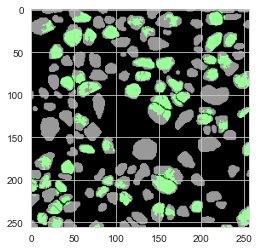

Fiji_sparse1
9 51 129 138
0.09090909090863178 3.1024602453132877


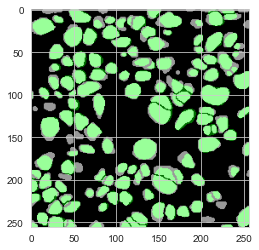

StarDist_sparse1
61 61 77 138
0.4692307692289645 2.546782667195342


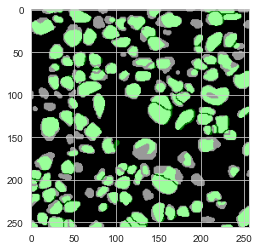

InForm_sparse1
44 58 94 138
0.3666666666651389 2.74782195974629


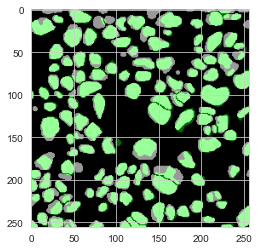

QuPath_sparse1
52 68 86 138
0.4031007751922361 2.812380641693593


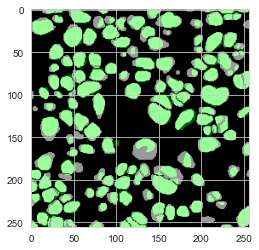

Mesmer_sparse1
61 79 77 138
0.4388489208617308 2.8832414726390168


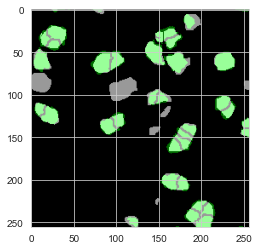

ilastik_sparse2
4 35 22 26
0.12307692307502958 3.371320343559643


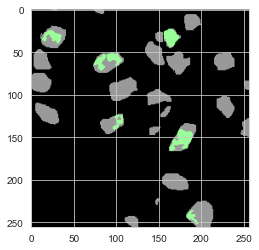

CellProfiler_sparse2
1 7 25 26
0.05882352941003461 2.23606797749979


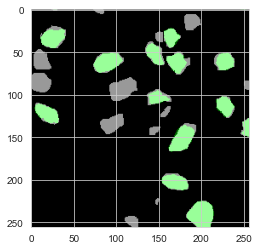

CellPose_sparse2
12 3 14 26
0.5853658536442594 3.138425387201398


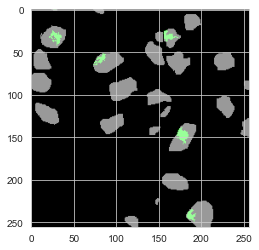

Fiji_sparse2
0 6 26 26
0.0 0


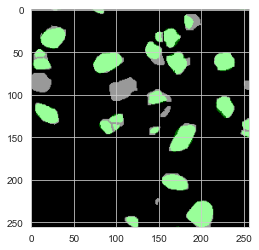

StarDist_sparse2
13 16 13 26
0.4727272727186777 2.628033580884565


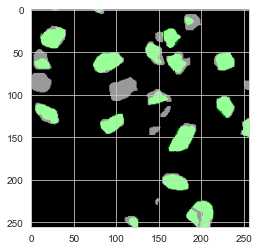

InForm_sparse2
10 11 16 26
0.42553191488456316 2.9651455947539107


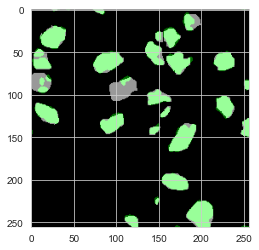

QuPath_sparse2
19 15 7 26
0.6333333333227779 2.5553156627962825


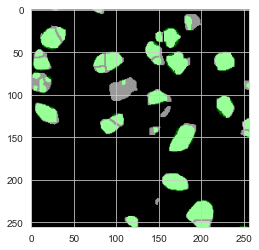

Mesmer_sparse2
11 27 15 26
0.3437499999946289 3.544474475919911


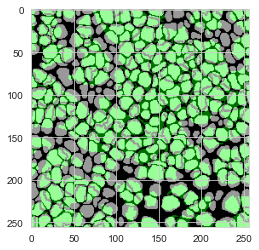

ilastik_dense1
4 151 301 305
0.01739130434778828 3.365713009399518


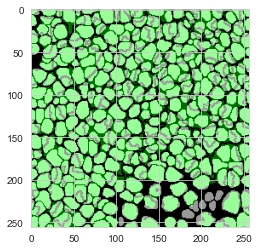

CellProfiler_dense1
28 147 277 305
0.11666666666642361 3.4421360603666344


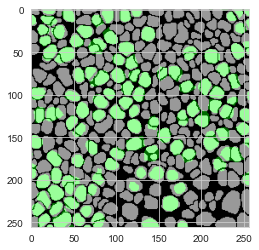

CellPose_dense1
54 65 251 305
0.25471698113147473 2.5477387656046804


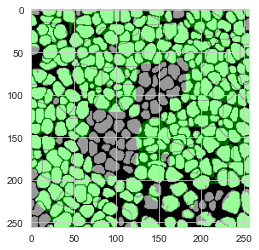

Fiji_dense1
35 87 270 305
0.16393442622912427 2.790801487313741


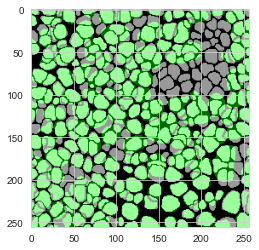

StarDist_dense1
42 110 263 305
0.1838074398245431 2.820691342601085


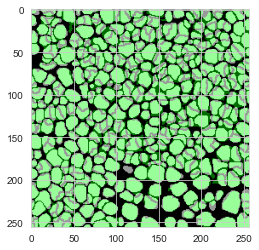

InForm_dense1
48 254 257 305
0.15815485996679052 3.003466713824945


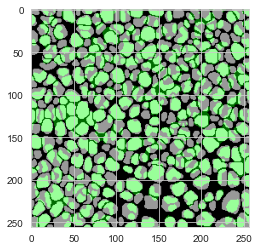

QuPath_dense1
22 196 283 305
0.08413001912029804 2.8395265761419304


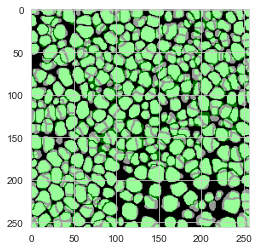

Mesmer_dense1
83 238 222 305
0.26517571884941665 2.823432632510683


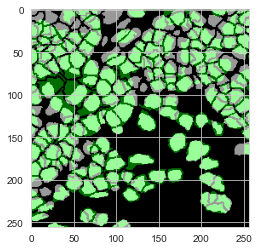

ilastik_dense2
8 123 173 181
0.05128205128188692 3.3738380981143212


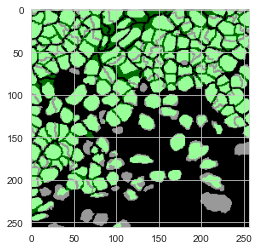

CellProfiler_dense2
27 91 154 181
0.18060200668835918 2.9109937361712093


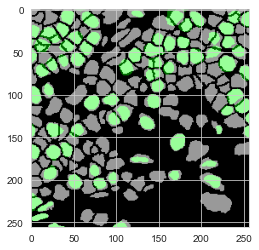

CellPose_dense2
34 44 147 181
0.26254826254724883 2.653168470290691


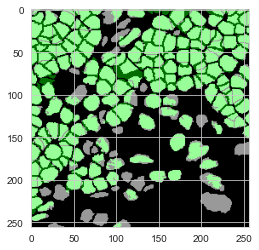

Fiji_dense2
39 73 142 181
0.26621160409465455 2.7798597250660846


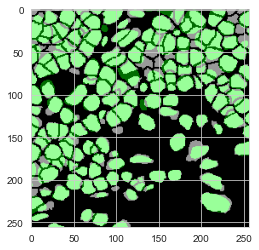

StarDist_dense2
63 75 118 181
0.3949843260175706 2.73277359075704


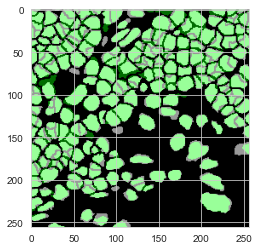

InForm_dense2
64 132 117 181
0.33952254641819757 2.6704673745048395


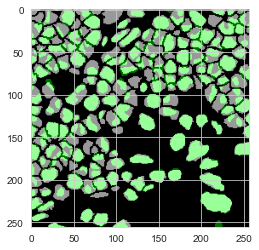

QuPath_dense2
34 122 147 181
0.20178041542966832 2.5378085989443147


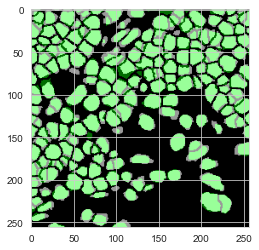

Mesmer_dense2
88 113 93 181
0.4607329842919876 2.80180450506756


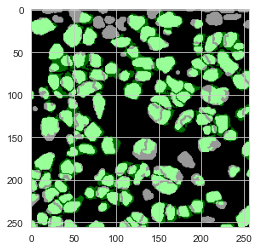

ilastik_sparse1
11 86 127 138
0.09361702127619738 3.6096673439424958


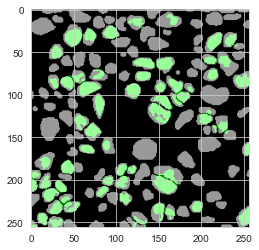

CellProfiler_sparse1
1 49 137 138
0.010638297872283839 2.8284271247461903


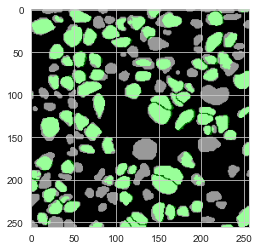

CellPose_sparse1
34 43 104 138
0.3162790697659708 2.436078446219092


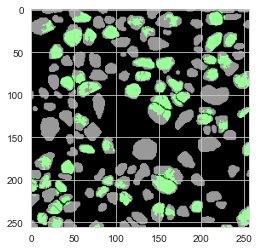

Fiji_sparse1
3 57 135 138
0.03030303030287726 3.1446594667367265


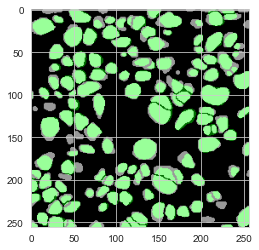

StarDist_sparse1
47 75 91 138
0.36153846153707103 2.2663688009939786


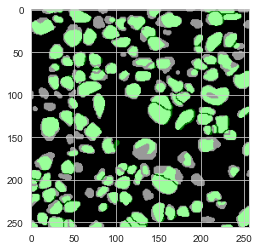

InForm_sparse1
28 74 110 138
0.23333333333236111 2.4537540411463583


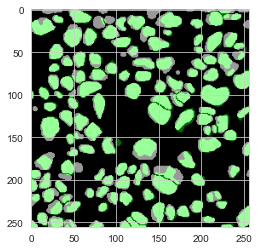

QuPath_sparse1
30 90 108 138
0.23255813953398236 2.5389847761197464


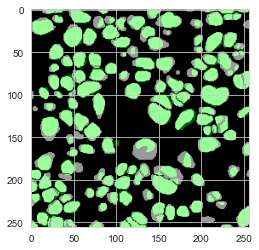

Mesmer_sparse1
47 93 91 138
0.3381294964016614 2.7187447638430036


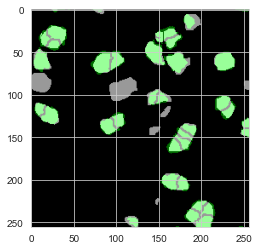

ilastik_sparse2
3 36 23 26
0.09230769230627218 2.60947570824873


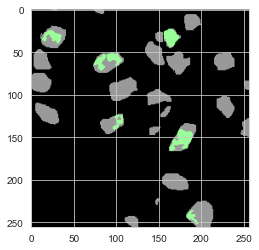

CellProfiler_sparse2
1 7 25 26
0.05882352941003461 2.23606797749979


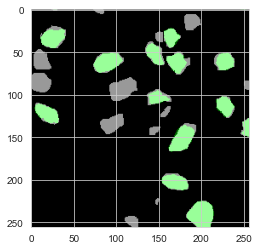

CellPose_sparse2
12 3 14 26
0.5853658536442594 3.138425387201398


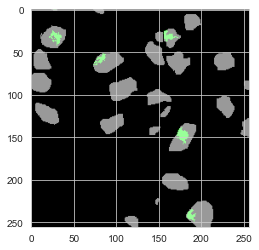

Fiji_sparse2
0 6 26 26
0.0 0


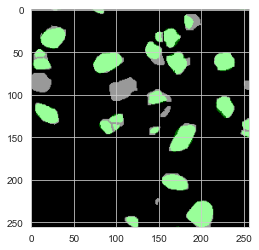

StarDist_sparse2
12 17 14 26
0.4363636363557025 2.680369712624946


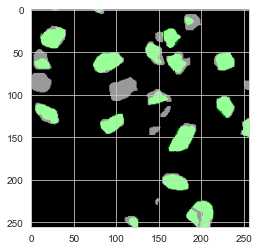

InForm_sparse2
10 11 16 26
0.42553191488456316 2.9651455947539107


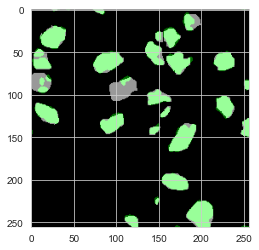

QuPath_sparse2
18 16 8 26
0.5999999999900001 2.4750554218405205


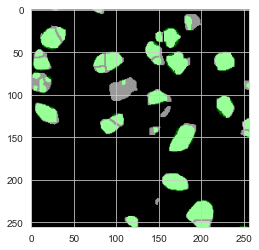

Mesmer_sparse2
8 30 18 26
0.24999999999609374 2.8612749651907796


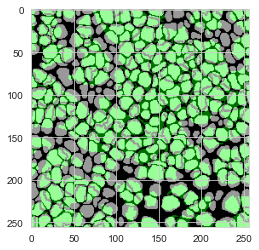

ilastik_dense1
2 153 303 305
0.00869565217389414 2.23606797749979


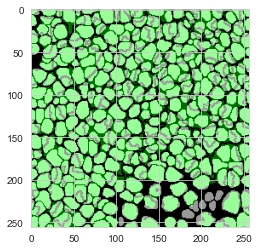

CellProfiler_dense1
17 158 288 305
0.07083333333318577 2.6301302390916375


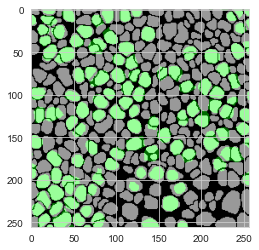

CellPose_dense1
42 77 263 305
0.19811320754670256 2.3101246293523183


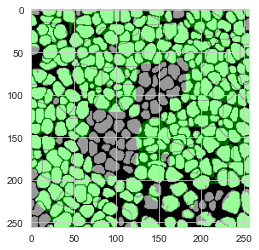

Fiji_dense1
28 94 277 305
0.13114754098329942 2.233691560527498


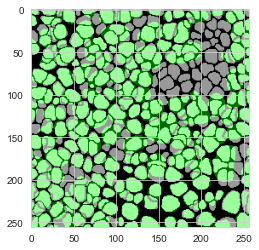

StarDist_dense1
26 126 279 305
0.11378555798662192 2.202802890296462


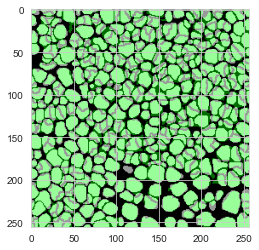

InForm_dense1
30 272 275 305
0.09884678747924408 2.5449604352895485


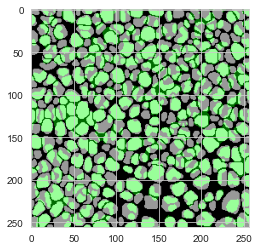

QuPath_dense1
14 204 291 305
0.05353728489473511 2.3372392394098833


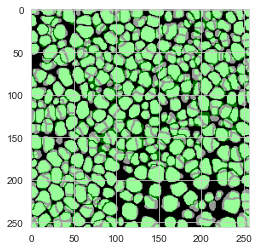

Mesmer_dense1
63 258 242 305
0.20127795527124398 2.539445852229257


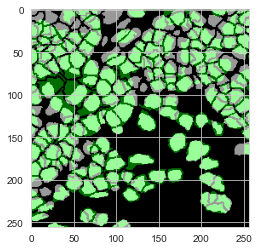

ilastik_dense2
5 126 176 181
0.032051282051179325 3.4


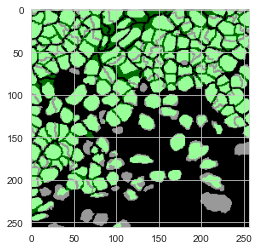

CellProfiler_dense2
21 97 160 181
0.14046822742427936 2.1510191577874744


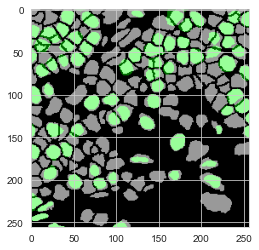

CellPose_dense2
26 52 155 181
0.2007722007714256 2.535701285522207


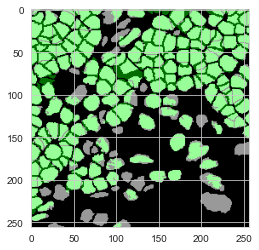

Fiji_dense2
32 80 149 181
0.21843003412894735 2.6614997399164326


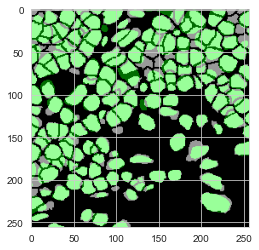

StarDist_dense2
47 91 134 181
0.2946708463940606 2.2609443843692216


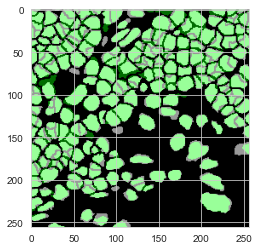

InForm_dense2
49 147 132 181
0.2599469496014325 2.5802394185006303


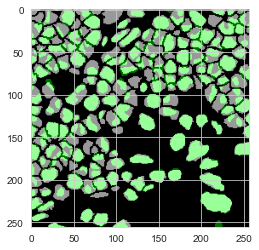

QuPath_dense2
27 129 154 181
0.16023738872356014 2.3364327788245993


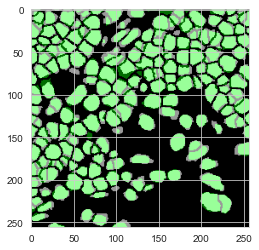

Mesmer_dense2
66 135 115 181
0.3455497382189907 2.6103547888404055


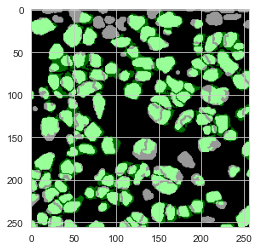

ilastik_sparse1
5 92 133 138
0.042553191489180624 3.119251212075712


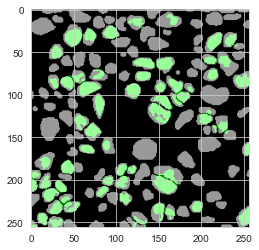

CellProfiler_sparse1
0 50 138 138
0.0 0


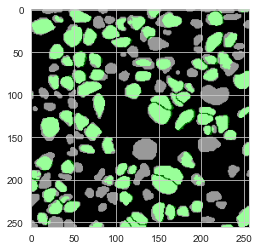

CellPose_sparse1
21 56 117 138
0.19534883720839374 2.1246263815286364


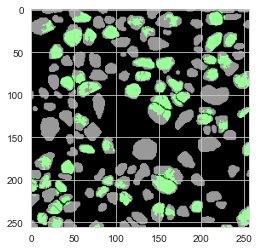

Fiji_sparse1
1 59 137 138
0.010101010100959087 2.8284271247461903


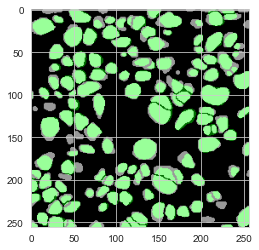

StarDist_sparse1
27 95 111 138
0.20769230769150887 2.0004673043110626


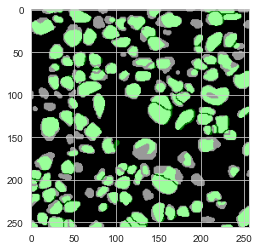

InForm_sparse1
18 84 120 138
0.149999999999375 2.169855232765899


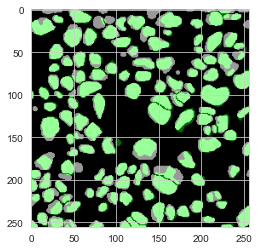

QuPath_sparse1
14 106 124 138
0.1085271317825251 2.280405819987736


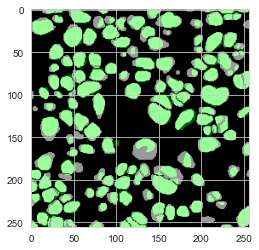

Mesmer_sparse1
21 119 117 138
0.15107913669010403 2.451471569868796


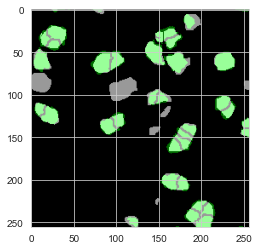

ilastik_sparse2
2 37 24 26
0.06153846153751479 2.414213562373095


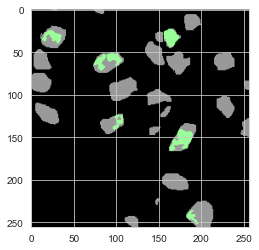

CellProfiler_sparse2
1 7 25 26
0.05882352941003461 2.23606797749979


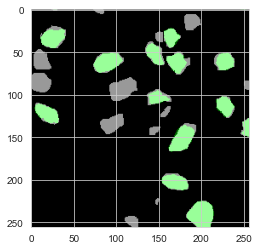

CellPose_sparse2
10 5 16 26
0.4878048780368828 2.842955328423773


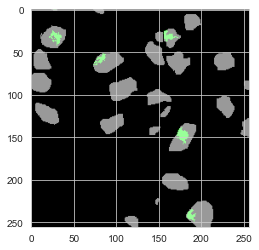

Fiji_sparse2
0 6 26 26
0.0 0


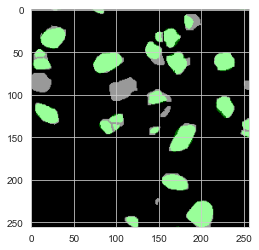

StarDist_sparse2
11 18 15 26
0.3999999999927273 2.742221504681759


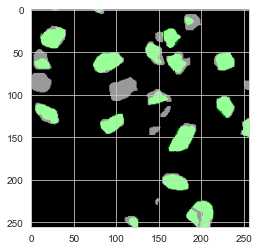

InForm_sparse2
9 12 17 26
0.3829787233961069 2.9432420319300814


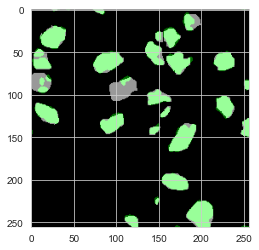

QuPath_sparse2
17 17 9 26
0.5666666666572222 2.4891135068017403


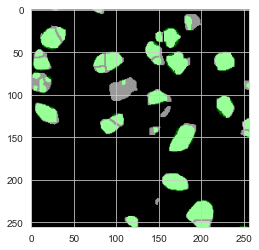

Mesmer_sparse2
8 30 18 26
0.24999999999609374 2.8612749651907796


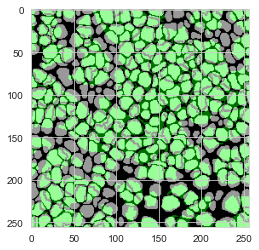

ilastik_dense1
2 153 303 305
0.00869565217389414 2.23606797749979


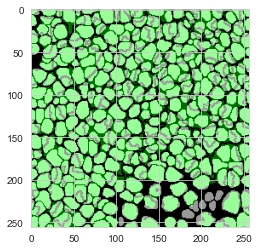

CellProfiler_dense1
9 166 296 305
0.037499999999921874 2.0596256730272846


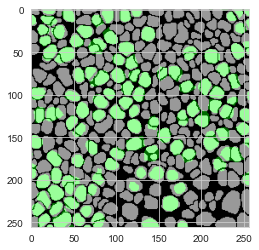

CellPose_dense1
25 94 280 305
0.11792452830160867 2.0170732311508717


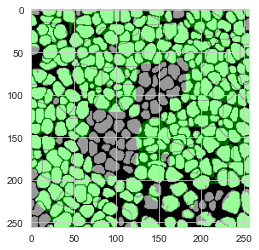

Fiji_dense1
20 102 285 305
0.09367681498807101 1.9177881483453159


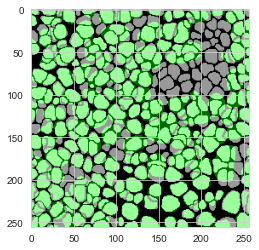

StarDist_dense1
18 134 287 305
0.07877461706766133 1.8142696805273546


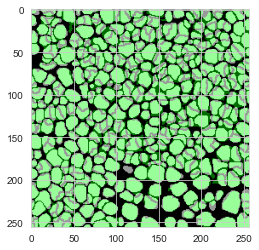

InForm_dense1
21 281 284 305
0.06919275123547085 2.085668408676282


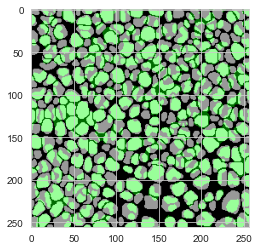

QuPath_dense1
5 213 300 305
0.019120458890976827 1.365685424949238


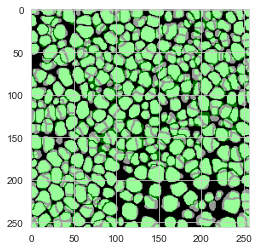

Mesmer_dense1
30 291 275 305
0.09584664536725904 1.99479222822036


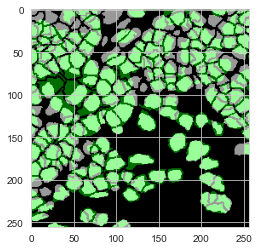

ilastik_dense2
2 129 179 181
0.01282051282047173 3.0


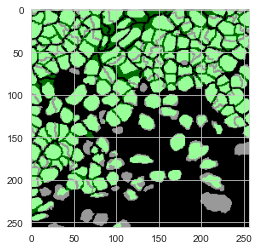

CellProfiler_dense2
14 104 167 181
0.09364548494951959 1.980302270364943


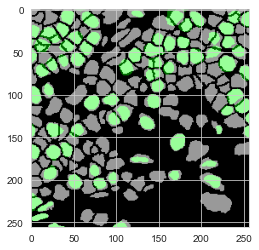

CellPose_dense2
11 67 170 181
0.08494208494175698 1.9202197722611332


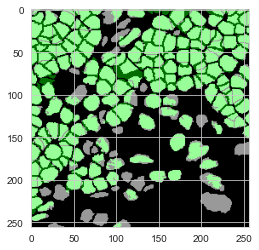

Fiji_dense2
22 90 159 181
0.1501706484636513 2.360364853940631


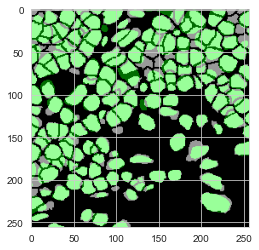

StarDist_dense2
39 99 142 181
0.2445141065823056 2.05944234915238


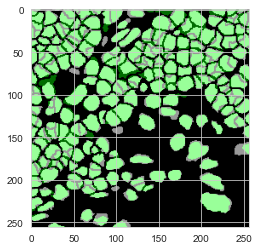

InForm_dense2
29 167 152 181
0.15384615384574576 2.0257640929777456


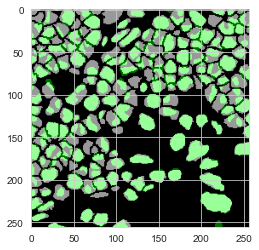

QuPath_dense2
19 137 162 181
0.11275964391657935 1.9788633502118738


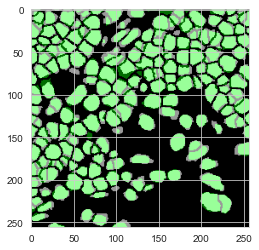

Mesmer_dense2
35 166 146 181
0.18324607329794962 2.118597218170745


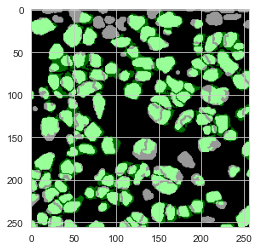

ilastik_sparse1
1 96 137 138
0.008510638297836125 2.0


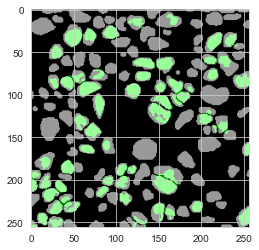

CellProfiler_sparse1
0 50 138 138
0.0 0


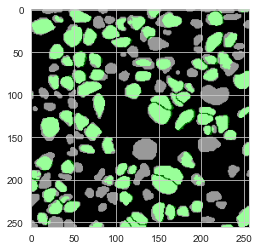

CellPose_sparse1
7 70 131 138
0.06511627906946457 1.8501206599455222


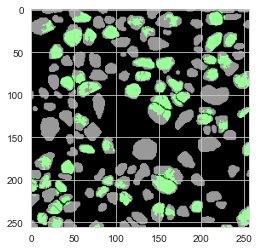

Fiji_sparse1
0 60 138 138
0.0 0


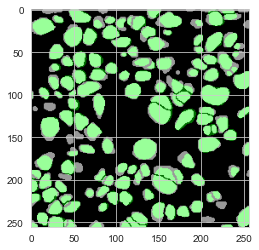

StarDist_sparse1
13 109 125 138
0.09999999999961538 1.7027356087778043


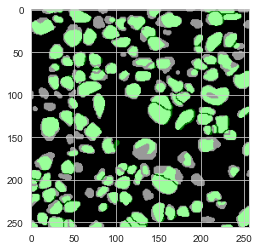

InForm_sparse1
4 98 134 138
0.033333333333194444 1.6035533905932737


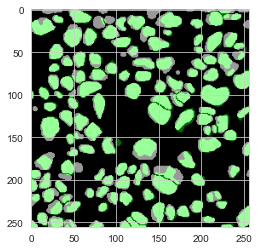

QuPath_sparse1
4 116 134 138
0.03100775193786431 2.016123775561495


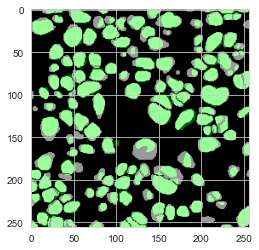

Mesmer_sparse1
7 133 131 138
0.05035971223003468 1.9500402199818407


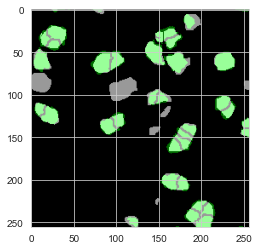

ilastik_sparse2
1 38 25 26
0.030769230768757396 2.0


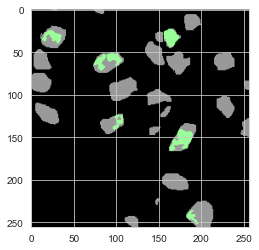

CellProfiler_sparse2
0 8 26 26
0.0 0


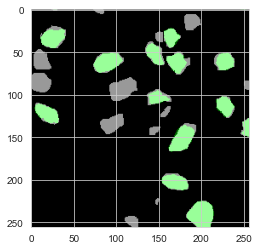

CellPose_sparse2
5 10 21 26
0.2439024390184414 2.060112615949154


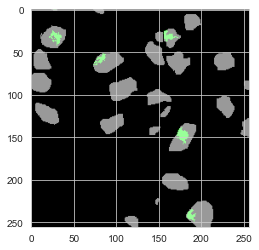

Fiji_sparse2
0 6 26 26
0.0 0


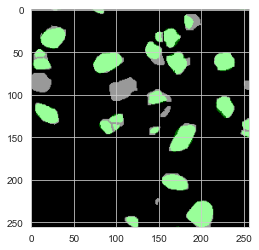

StarDist_sparse2
8 21 18 26
0.2909090909038017 2.567900470858132


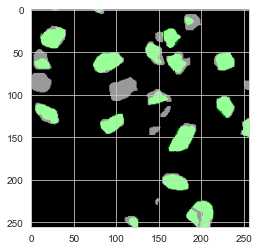

InForm_sparse2
6 15 20 26
0.2553191489307379 2.9148630478951216


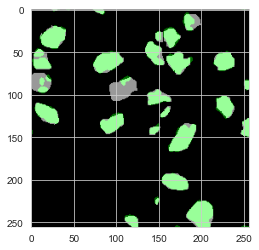

QuPath_sparse2
11 23 15 26
0.3666666666605556 2.5670220350150923


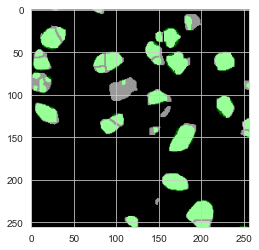

Mesmer_sparse2
2 36 24 26
0.062499999999023434 1.7071067811865475


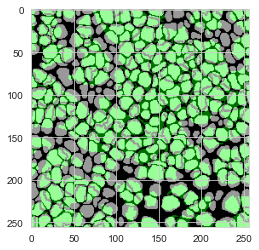

ilastik_dense1
0 155 305 305
0.0 0


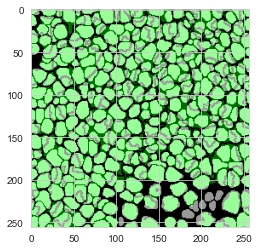

CellProfiler_dense1
3 172 302 305
0.012499999999973959 1.9621165057908916


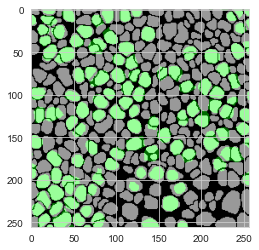

CellPose_dense1
10 109 295 305
0.04716981132064347 1.7307135789365269


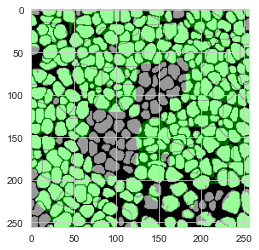

Fiji_dense1
10 112 295 305
0.046838407494035506 1.6478708664619077


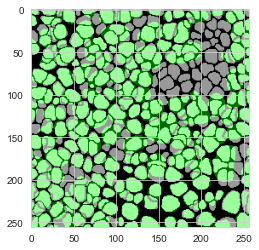

StarDist_dense1
12 140 293 305
0.05251641137844088 1.6035533905932737


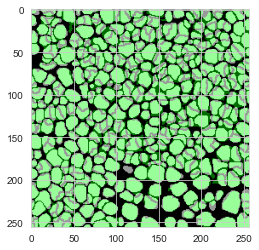

InForm_dense1
7 295 298 305
0.02306425041182362 1.614366154249396


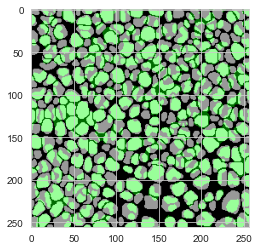

QuPath_dense1
1 217 304 305
0.0038240917781953653 1.4142135623730951


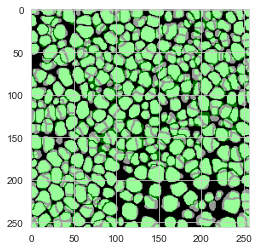

Mesmer_dense1
13 308 292 305
0.04153354632581225 1.5439282932204215


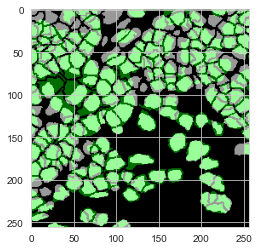

ilastik_dense2
0 131 181 181
0.0 0


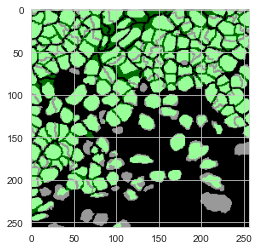

CellProfiler_dense2
8 110 173 181
0.05351170568543976 1.7143470802648582


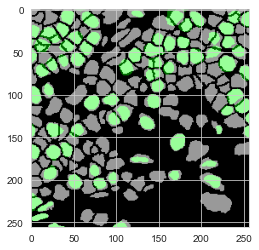

CellPose_dense2
5 73 176 181
0.03861003860988954 1.482842712474619


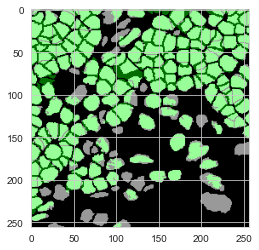

Fiji_dense2
8 104 173 181
0.05460750853223684 1.2580618877807475


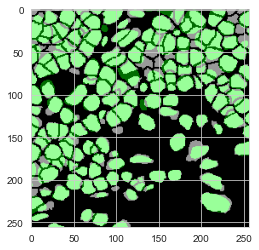

StarDist_dense2
17 121 164 181
0.10658307209997937 1.732561501460513


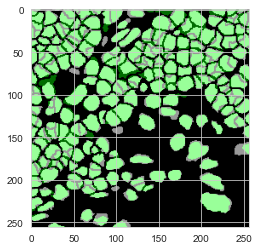

InForm_dense2
14 182 167 181
0.07427055702898072 1.925999288489832


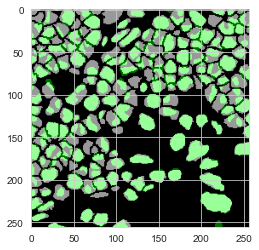

QuPath_dense2
9 147 172 181
0.05341246290785338 1.727022640762784


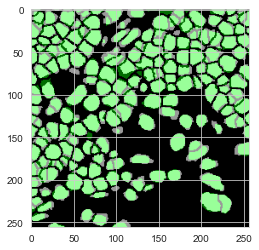

Mesmer_dense2
17 184 164 181
0.08900523560186124 1.7827726934920747


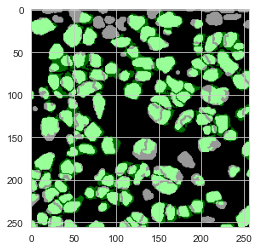

ilastik_sparse1
1 96 137 138
0.008510638297836125 2.0


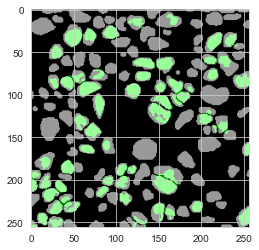

CellProfiler_sparse1
0 50 138 138
0.0 0


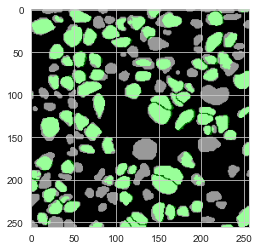

CellPose_sparse1
1 76 137 138
0.009302325581352083 2.23606797749979


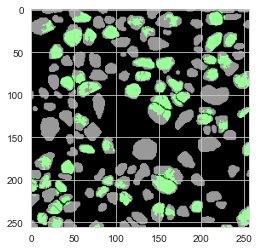

Fiji_sparse1
0 60 138 138
0.0 0


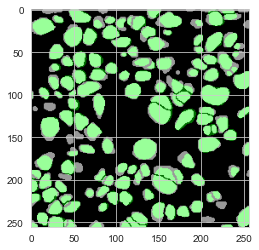

StarDist_sparse1
2 120 136 138
0.015384615384556214 2.0


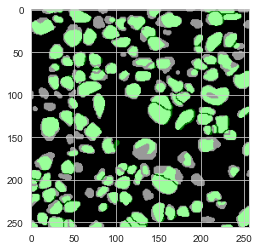

InForm_sparse1
2 100 136 138
0.016666666666597222 2.0


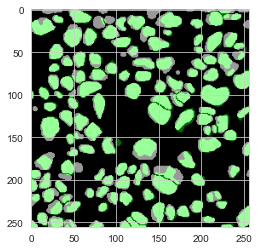

QuPath_sparse1
0 120 138 138
0.0 0


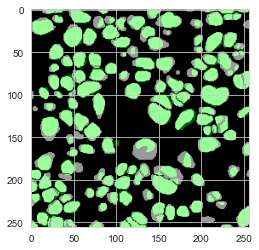

Mesmer_sparse1
1 139 137 138
0.0071942446042906685 1.4142135623730951


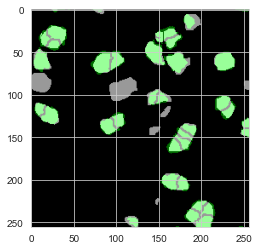

ilastik_sparse2
0 39 26 26
0.0 0


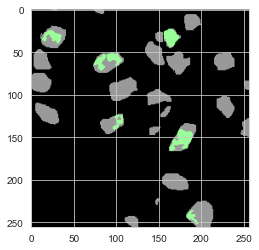

CellProfiler_sparse2
0 8 26 26
0.0 0


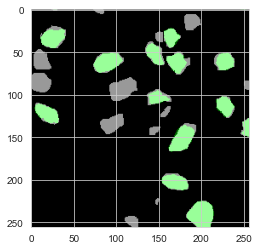

CellPose_sparse2
1 14 25 26
0.04878048780368829 1.0


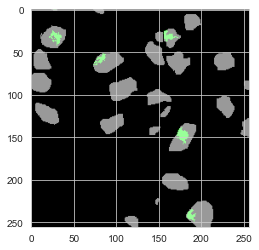

Fiji_sparse2
0 6 26 26
0.0 0


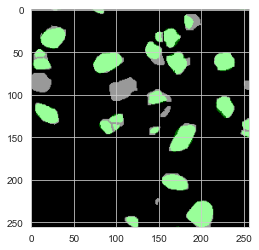

StarDist_sparse2
3 26 23 26
0.10909090908892563 2.159569554873025


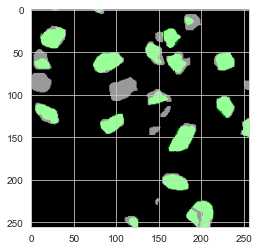

InForm_sparse2
1 20 25 26
0.04255319148845632 2.8284271247461903


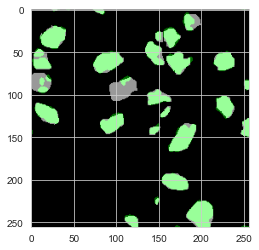

QuPath_sparse2
2 32 24 26
0.06666666666555555 1.7071067811865475


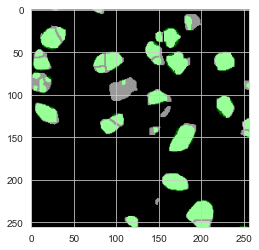

Mesmer_sparse2
1 37 25 26
0.031249999999511717 1.4142135623730951


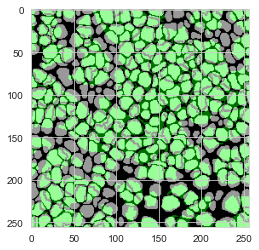

ilastik_dense1
0 155 305 305
0.0 0


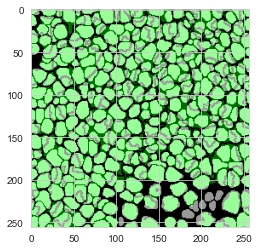

CellProfiler_dense1
1 174 304 305
0.004166666666657986 1.4142135623730951


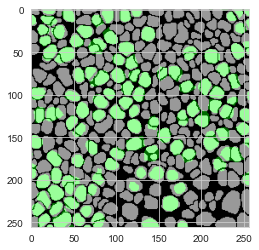

CellPose_dense1
0 119 305 305
0.0 0


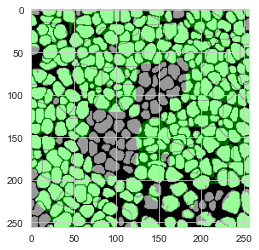

Fiji_dense1
5 117 300 305
0.023419203747017753 1.365685424949238


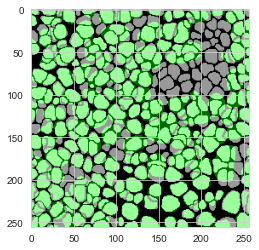

StarDist_dense1
3 149 302 305
0.01312910284461022 1.6666666666666667


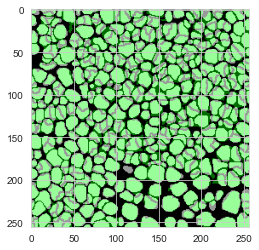

InForm_dense1
2 300 303 305
0.0065897858319496055 1.2071067811865475


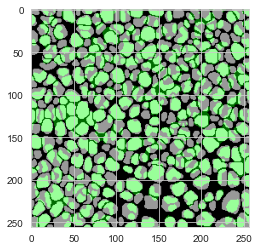

QuPath_dense1
1 217 304 305
0.0038240917781953653 1.4142135623730951


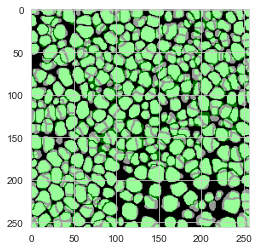

Mesmer_dense1
5 316 300 305
0.01597444089454317 1.282842712474619


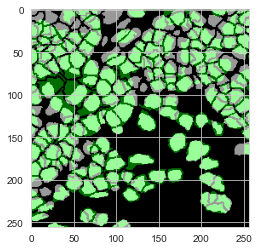

ilastik_dense2
0 131 181 181
0.0 0


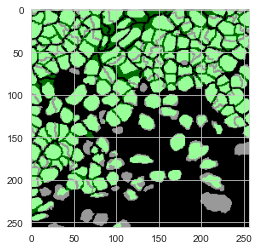

CellProfiler_dense2
1 117 180 181
0.00668896321067997 1.4142135623730951


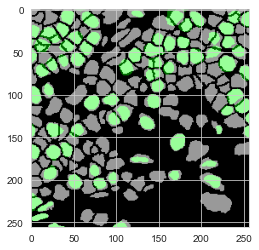

CellPose_dense2
1 77 180 181
0.0077220077219779075 1.0


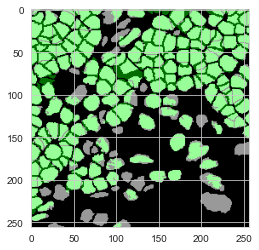

Fiji_dense2
2 110 179 181
0.01365187713305921 1.0


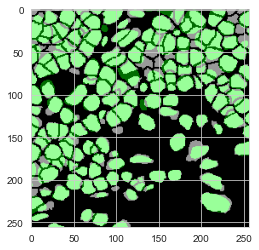

StarDist_dense2
6 132 175 181
0.037617554858816245 1.304737854124365


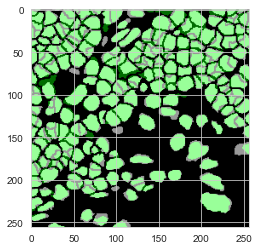

InForm_dense2
4 192 177 181
0.021220159151137348 1.5606601717798214


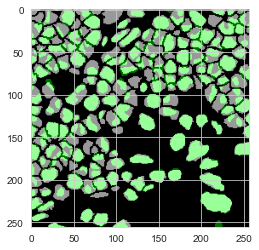

QuPath_dense2
2 154 179 181
0.011869436201745196 1.4142135623730951


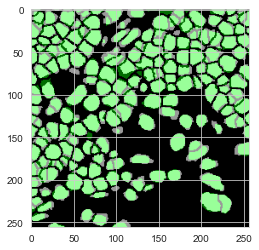

Mesmer_dense2
2 199 179 181
0.010471204188454264 1.0


In [8]:
# Initializing the dictionary which will contain the F1-scores (averaged over 4 subfields)
df_mean_dict = {}
df_mean = pd.DataFrame(df_mean_dict)

# Iterating for various IoU thresholds
for IoU_thresh in [0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9]:

    # this dictionary will be populated with IoU thresholds and their associated mean F1 scores for each platform.
    # Alter the keys of the dictionary to include the platforms being implemented
    df_dict_F1 = {'subfield': [], 'ilastik': [], 'CellProfiler': [], 'Fiji': [], 'QuPath': [],
                                'Mesmer': [], 'InForm': [], 'CellPose': [], 'StarDist': []}

    # iterating over all 4 subfields
    for subfield in gr_tr_mask_dict.keys():
        # iterating over each platform's binary mask
        for img in os.listdir(platforms_dir_path):
            # only processed tiff files
            if img[-5:]=='.tiff' or img[-4:]=='.tif':
                platform_whole_img = io.imread(os.path.join(platforms_dir_path, img))
                platform = img[:img.find('.')]
                # adds a new entry in the dictionary for the subfield if it is not already added
                if subfield not in df_dict_F1['subfield']:
                    df_dict_F1['subfield'].append(subfield)
                else:
                    pass
                # gets the ground truth mask for the current subfield
                gr_tr_img = gr_tr_mask_dict[subfield]
                # gets the coordinates for the current subfield
                top_left_row = coordinate_dict[subfield][0]
                top_left_column = coordinate_dict[subfield][1]
                # crops the platform binary mask to isolate the region to be evaluated
                platform_img = platform_whole_img[top_left_row:top_left_row+256,
                                                  top_left_column:top_left_column+256]
                # creating a ground truth binary mask for visualization purposes in white and black
                gr_tr_img_show = np.uint8(np.zeros((gr_tr_img.shape[0], gr_tr_img.shape[1], 3)))
                gr_tr_img_show[gr_tr_img == 255] = [255, 255, 255]
                # creating a ground truth binary mask for visualization purposes in green and black
                platform_img_show = np.uint8(np.zeros((platform_img.shape[0], platform_img.shape[1], 3)))
                platform_img_show[platform_img == 255] = [0, 120, 0]
                # overlaying the platform over the ground truth binary mask
                dst = cv2.addWeighted(gr_tr_img_show, 0.6, platform_img_show, 0.9, 0)
                # for visualization in the notebook
                plt.imshow(dst)
                plt.show()

                print(platform + '_' + subfield)
                accuracy = accuracy_calculator(platform_img, gr_tr_img)
                # calculating the F1-score of the current platform subfield at the current IoU threshold
                F1, nuclei_count, cur_gr_tr_nuclei_count, aHD = F1_score_calculator(platform_img, gr_tr_img,
                                                                                    IoU_thresh)
                # Adding the F1-score to the F1-score dictionary
                df_dict_F1[platform].append(F1)
            else:
                pass
    # Converting the F1-score dictionary to a dataframe
    df_F1 = pd.DataFrame(df_dict_F1)
    # Setting the index to be the subfield name
    df_F1 = df_F1.set_index('subfield')

    # Calculating the mean F1-score over the 4 subfields for each IoU threshold
    df_mean[str(IoU_thresh)] = df_F1.mean()

/var/folders/tb/t9xd8_k12c79sjm8cjqmr_x80000gn/T/ipykernel_53962/4291514603.py:2: UserWarning: 
The markers list has fewer values (1) than needed (8) and will cycle, which may produce an uninterpretable plot.
  mean_F1_barplot = sns.lineplot(data=df_mean_transpose, dashes=False, markers='s', legend=False)


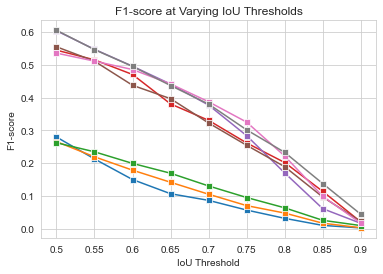

In [10]:
df_mean_transpose = df_mean.transpose()
mean_F1_barplot = sns.lineplot(data=df_mean_transpose, dashes=False, markers='s', legend=True)
mean_F1_barplot.set(xlabel ="IoU Threshold", ylabel = "F1-score", title ='F1-score at Varying IoU Thresholds')
plt.savefig(F1_allIoU_plot_path, dpi=500)